# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

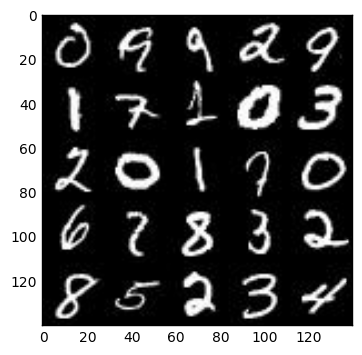

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

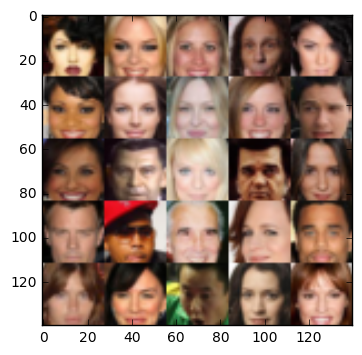

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [4]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.1.0
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [5]:
import problem_unittests as tests
import tensorflow as tf

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    the_input = tf.placeholder(tf.float32, shape=[None, image_width, image_height, image_channels], name='input')
    z_input = tf.placeholder(tf.float32, shape=[None, z_dim], name='z_input')
    lr = tf.placeholder(tf.float32, shape=[], name='learning_rate')

    return the_input, z_input, lr


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [6]:
def discriminator(images, reuse=False, n_units=128, alpha=0.2, drop_rate=0.25):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    #Using DCGAN lesson as example
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 28x28*(1 or 3)
        x1 = tf.layers.conv2d(images, 64, 5, strides=2, kernel_initializer=tf.contrib.layers.xavier_initializer(), padding='same')
        x1 = tf.layers.dropout(x1, rate=drop_rate)
        relu1 = tf.maximum(alpha * x1, x1)
        # 14x14x64
 
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, kernel_initializer=tf.contrib.layers.xavier_initializer(), padding='same')
        x2 = tf.layers.dropout(x2, rate=drop_rate)
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 7x7x128
       
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, kernel_initializer=tf.contrib.layers.xavier_initializer(), padding='same')
        x3 = tf.layers.dropout(x3, rate=drop_rate)
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256
       
        
        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [7]:
def leaky_relu(x, alpha):
    return tf.maximum(alpha * x, x)

def generator(z, out_dim, is_train=True, n_units=128, alpha=0.2):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """

    # Starting with code from DCGAN example
    with tf.variable_scope('generator', reuse=(not is_train)):
        # First fully connected layer
        x1 = tf.layers.dense(z, 2*2*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 2, 2, 512))
        x1 = tf.layers.batch_normalization(x1, training=is_train)
        x1 = leaky_relu(x1, alpha)
        #print(x1)
        # 7x7x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='valid')
        x2 = tf.layers.batch_normalization(x2, training=is_train)
        x2 = leaky_relu(x2, alpha)
        #print(x2)
        # 14x14x256 now
        
        x2 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=is_train)
        x2 = leaky_relu(x2, alpha)
        #print(x2)

        logits = tf.layers.conv2d_transpose(x2, out_dim, 5, strides=2, padding='same')
        #print(logits)
        
        out = tf.tanh(logits)
        
        return out

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [8]:
def model_loss(input_real, input_z, output_dim, smooth=0.1, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
   
    
    
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)* (1-smooth)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    
    
    
    
    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [9]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
  
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)


    return d_train_opt, g_train_opt

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [10]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [11]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model
    losses = []

    with tf.Session() as sess:

        input_real, input_z, learning_rate_var = model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
        count = 0;
        d_loss, g_loss = model_loss(input_real, input_z, data_shape[3])
        d_train_opt, g_train_opt = model_opt(d_loss, g_loss, learning_rate, beta1)

        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                # TODO: Train Model
    
                batch_images = 2* batch_images
                batch_z = np.random.uniform(-1,1, size=(batch_size, z_dim))
                _ = sess.run(d_train_opt, feed_dict={input_real: batch_images, input_z: batch_z})

                _ = sess.run(g_train_opt, feed_dict={input_z: batch_z, input_real: batch_images})
                _ = sess.run(g_train_opt, feed_dict={input_z: batch_z, input_real: batch_images})
        
                # At the end of each epoch, get the losses and print them out
                #train_loss_d = sess.run(d_loss, {input_z: batch_z, input_real: batch_images})
                train_loss_d = d_loss.eval({input_z: batch_z, input_real: batch_images})
                train_loss_g = g_loss.eval({input_z: batch_z})
            
                print("{} Epoch {}/{}...".format(count, epoch_i+1, epochs),
                      "Discriminator Loss: {:.4f}...".format(train_loss_d),
                      "Generator Loss: {:.4f}".format(train_loss_g))    
                # Save losses to view after training
                losses.append((train_loss_d, train_loss_g))

                if (count%100 == 0 ):
                    show_generator_output(sess, 25, input_z, data_shape[3], data_image_mode)
                count = count + 1

                
               

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

0 Epoch 1/2... Discriminator Loss: 5.8428... Generator Loss: 0.0050


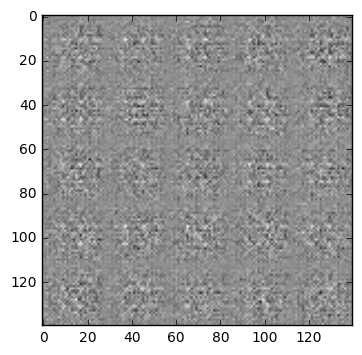

1 Epoch 1/2... Discriminator Loss: 5.8558... Generator Loss: 0.0045
2 Epoch 1/2... Discriminator Loss: 5.3335... Generator Loss: 0.0080
3 Epoch 1/2... Discriminator Loss: 4.8543... Generator Loss: 0.0136
4 Epoch 1/2... Discriminator Loss: 4.3296... Generator Loss: 0.0272
5 Epoch 1/2... Discriminator Loss: 4.0698... Generator Loss: 0.0329
6 Epoch 1/2... Discriminator Loss: 3.6501... Generator Loss: 0.0479
7 Epoch 1/2... Discriminator Loss: 3.1622... Generator Loss: 0.0844
8 Epoch 1/2... Discriminator Loss: 2.7129... Generator Loss: 0.1374
9 Epoch 1/2... Discriminator Loss: 2.5775... Generator Loss: 0.1355
10 Epoch 1/2... Discriminator Loss: 2.6399... Generator Loss: 0.1488
11 Epoch 1/2... Discriminator Loss: 2.1220... Generator Loss: 0.2497
12 Epoch 1/2... Discriminator Loss: 1.9340... Generator Loss: 0.3186
13 Epoch 1/2... Discriminator Loss: 1.5254... Generator Loss: 0.4574
14 Epoch 1/2... Discriminator Loss: 1.6230... Generator Loss: 0.4370
15 Epoch 1/2... Discriminator Loss: 1.5236.

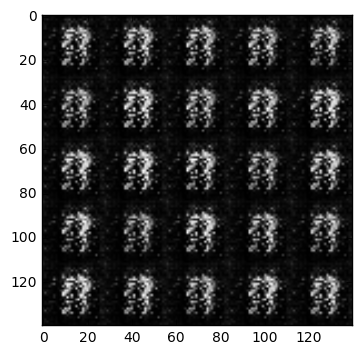

101 Epoch 1/2... Discriminator Loss: 0.9139... Generator Loss: 1.6169
102 Epoch 1/2... Discriminator Loss: 0.7276... Generator Loss: 1.6573
103 Epoch 1/2... Discriminator Loss: 0.6222... Generator Loss: 1.8212
104 Epoch 1/2... Discriminator Loss: 0.7101... Generator Loss: 1.5736
105 Epoch 1/2... Discriminator Loss: 0.7633... Generator Loss: 1.3688
106 Epoch 1/2... Discriminator Loss: 0.8317... Generator Loss: 1.3843
107 Epoch 1/2... Discriminator Loss: 0.8738... Generator Loss: 1.5818
108 Epoch 1/2... Discriminator Loss: 0.9303... Generator Loss: 1.1385
109 Epoch 1/2... Discriminator Loss: 0.9845... Generator Loss: 1.0538
110 Epoch 1/2... Discriminator Loss: 0.9395... Generator Loss: 1.5504
111 Epoch 1/2... Discriminator Loss: 0.9328... Generator Loss: 1.2560
112 Epoch 1/2... Discriminator Loss: 0.8581... Generator Loss: 1.2659
113 Epoch 1/2... Discriminator Loss: 0.7479... Generator Loss: 1.6958
114 Epoch 1/2... Discriminator Loss: 0.7713... Generator Loss: 1.4748
115 Epoch 1/2... Dis

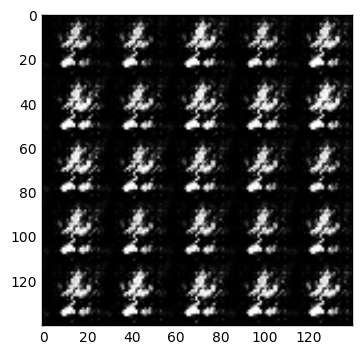

201 Epoch 1/2... Discriminator Loss: 0.7200... Generator Loss: 1.6481
202 Epoch 1/2... Discriminator Loss: 0.5596... Generator Loss: 2.2279
203 Epoch 1/2... Discriminator Loss: 0.6293... Generator Loss: 2.1767
204 Epoch 1/2... Discriminator Loss: 0.7240... Generator Loss: 1.6865
205 Epoch 1/2... Discriminator Loss: 0.5712... Generator Loss: 2.1655
206 Epoch 1/2... Discriminator Loss: 0.5659... Generator Loss: 2.0149
207 Epoch 1/2... Discriminator Loss: 0.6051... Generator Loss: 1.9363
208 Epoch 1/2... Discriminator Loss: 0.6525... Generator Loss: 1.7663
209 Epoch 1/2... Discriminator Loss: 0.5970... Generator Loss: 1.9404
210 Epoch 1/2... Discriminator Loss: 0.6424... Generator Loss: 1.9111
211 Epoch 1/2... Discriminator Loss: 0.8086... Generator Loss: 1.5434
212 Epoch 1/2... Discriminator Loss: 0.7539... Generator Loss: 1.6269
213 Epoch 1/2... Discriminator Loss: 0.5807... Generator Loss: 2.1289
214 Epoch 1/2... Discriminator Loss: 0.5054... Generator Loss: 2.2757
215 Epoch 1/2... Dis

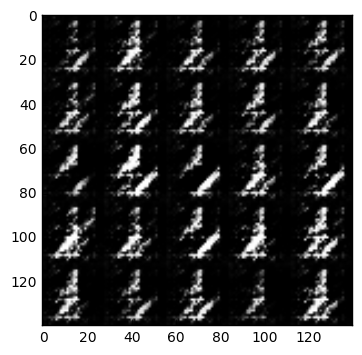

301 Epoch 1/2... Discriminator Loss: 0.6930... Generator Loss: 2.1293
302 Epoch 1/2... Discriminator Loss: 0.8160... Generator Loss: 1.5094
303 Epoch 1/2... Discriminator Loss: 0.6069... Generator Loss: 1.9648
304 Epoch 1/2... Discriminator Loss: 0.7891... Generator Loss: 1.5516
305 Epoch 1/2... Discriminator Loss: 0.6790... Generator Loss: 1.8371
306 Epoch 1/2... Discriminator Loss: 0.7216... Generator Loss: 2.1314
307 Epoch 1/2... Discriminator Loss: 0.7418... Generator Loss: 2.0367
308 Epoch 1/2... Discriminator Loss: 0.7977... Generator Loss: 1.2913
309 Epoch 1/2... Discriminator Loss: 0.7404... Generator Loss: 1.6428
310 Epoch 1/2... Discriminator Loss: 0.7890... Generator Loss: 1.6497
311 Epoch 1/2... Discriminator Loss: 0.8943... Generator Loss: 1.3955
312 Epoch 1/2... Discriminator Loss: 1.1496... Generator Loss: 0.9689
313 Epoch 1/2... Discriminator Loss: 1.0976... Generator Loss: 1.7775
314 Epoch 1/2... Discriminator Loss: 1.2081... Generator Loss: 0.8954
315 Epoch 1/2... Dis

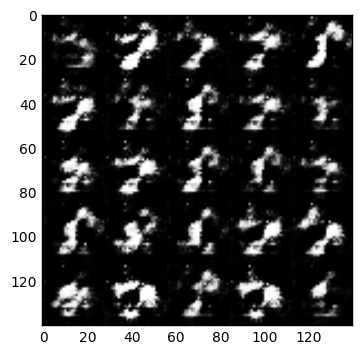

401 Epoch 1/2... Discriminator Loss: 0.8955... Generator Loss: 1.8563
402 Epoch 1/2... Discriminator Loss: 1.2232... Generator Loss: 0.8253
403 Epoch 1/2... Discriminator Loss: 1.0613... Generator Loss: 1.0912
404 Epoch 1/2... Discriminator Loss: 1.0409... Generator Loss: 1.8168
405 Epoch 1/2... Discriminator Loss: 1.4027... Generator Loss: 0.6754
406 Epoch 1/2... Discriminator Loss: 1.1887... Generator Loss: 1.5869
407 Epoch 1/2... Discriminator Loss: 0.7573... Generator Loss: 1.6768
408 Epoch 1/2... Discriminator Loss: 0.9841... Generator Loss: 1.0882
409 Epoch 1/2... Discriminator Loss: 0.7661... Generator Loss: 1.7364
410 Epoch 1/2... Discriminator Loss: 0.8751... Generator Loss: 1.5740
411 Epoch 1/2... Discriminator Loss: 0.9341... Generator Loss: 1.3915
412 Epoch 1/2... Discriminator Loss: 0.9268... Generator Loss: 1.3499
413 Epoch 1/2... Discriminator Loss: 1.0685... Generator Loss: 1.0455
414 Epoch 1/2... Discriminator Loss: 0.9889... Generator Loss: 1.1498
415 Epoch 1/2... Dis

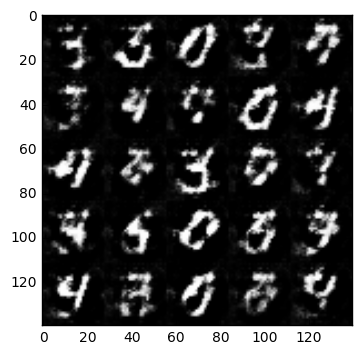

501 Epoch 1/2... Discriminator Loss: 1.2551... Generator Loss: 1.0935
502 Epoch 1/2... Discriminator Loss: 1.1959... Generator Loss: 0.9410
503 Epoch 1/2... Discriminator Loss: 1.0865... Generator Loss: 1.2945
504 Epoch 1/2... Discriminator Loss: 1.0834... Generator Loss: 0.8648
505 Epoch 1/2... Discriminator Loss: 0.9615... Generator Loss: 1.3323
506 Epoch 1/2... Discriminator Loss: 1.1516... Generator Loss: 1.1085
507 Epoch 1/2... Discriminator Loss: 1.1001... Generator Loss: 1.2908
508 Epoch 1/2... Discriminator Loss: 1.2190... Generator Loss: 0.8573
509 Epoch 1/2... Discriminator Loss: 1.2138... Generator Loss: 0.9060
510 Epoch 1/2... Discriminator Loss: 1.2081... Generator Loss: 1.2419
511 Epoch 1/2... Discriminator Loss: 1.3046... Generator Loss: 0.8208
512 Epoch 1/2... Discriminator Loss: 1.0755... Generator Loss: 1.1395
513 Epoch 1/2... Discriminator Loss: 1.0467... Generator Loss: 1.1564
514 Epoch 1/2... Discriminator Loss: 1.0251... Generator Loss: 1.1669
515 Epoch 1/2... Dis

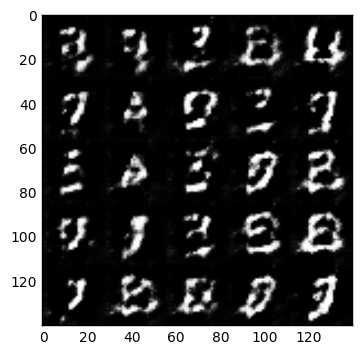

601 Epoch 1/2... Discriminator Loss: 1.0544... Generator Loss: 0.9618
602 Epoch 1/2... Discriminator Loss: 1.0875... Generator Loss: 1.0212
603 Epoch 1/2... Discriminator Loss: 0.9964... Generator Loss: 1.4027
604 Epoch 1/2... Discriminator Loss: 1.0245... Generator Loss: 1.0561
605 Epoch 1/2... Discriminator Loss: 1.0273... Generator Loss: 1.1285
606 Epoch 1/2... Discriminator Loss: 1.2195... Generator Loss: 1.0309
607 Epoch 1/2... Discriminator Loss: 1.0550... Generator Loss: 1.1405
608 Epoch 1/2... Discriminator Loss: 1.2217... Generator Loss: 0.7436
609 Epoch 1/2... Discriminator Loss: 1.3385... Generator Loss: 1.0869
610 Epoch 1/2... Discriminator Loss: 1.1568... Generator Loss: 1.0237
611 Epoch 1/2... Discriminator Loss: 1.1752... Generator Loss: 0.7605
612 Epoch 1/2... Discriminator Loss: 1.1413... Generator Loss: 0.9941
613 Epoch 1/2... Discriminator Loss: 1.1284... Generator Loss: 1.0490
614 Epoch 1/2... Discriminator Loss: 1.1447... Generator Loss: 0.9181
615 Epoch 1/2... Dis

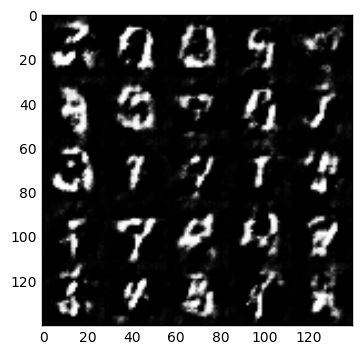

701 Epoch 1/2... Discriminator Loss: 1.1688... Generator Loss: 0.8328
702 Epoch 1/2... Discriminator Loss: 1.1891... Generator Loss: 1.1197
703 Epoch 1/2... Discriminator Loss: 1.2301... Generator Loss: 1.0623
704 Epoch 1/2... Discriminator Loss: 1.5285... Generator Loss: 0.5603
705 Epoch 1/2... Discriminator Loss: 1.2295... Generator Loss: 0.9690
706 Epoch 1/2... Discriminator Loss: 1.3070... Generator Loss: 0.9327
707 Epoch 1/2... Discriminator Loss: 1.3344... Generator Loss: 0.9155
708 Epoch 1/2... Discriminator Loss: 1.2457... Generator Loss: 0.7812
709 Epoch 1/2... Discriminator Loss: 1.1036... Generator Loss: 1.3374
710 Epoch 1/2... Discriminator Loss: 1.1730... Generator Loss: 0.7852
711 Epoch 1/2... Discriminator Loss: 1.0227... Generator Loss: 1.2233
712 Epoch 1/2... Discriminator Loss: 1.0618... Generator Loss: 1.0141
713 Epoch 1/2... Discriminator Loss: 1.0524... Generator Loss: 0.9023
714 Epoch 1/2... Discriminator Loss: 1.2651... Generator Loss: 0.7005
715 Epoch 1/2... Dis

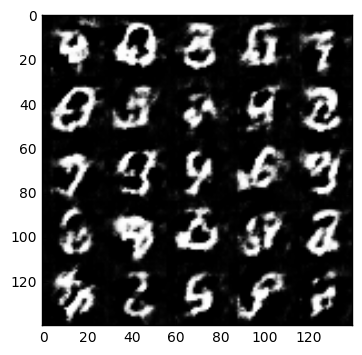

801 Epoch 1/2... Discriminator Loss: 1.3109... Generator Loss: 0.7917
802 Epoch 1/2... Discriminator Loss: 1.1548... Generator Loss: 1.1637
803 Epoch 1/2... Discriminator Loss: 1.0619... Generator Loss: 0.8510
804 Epoch 1/2... Discriminator Loss: 1.0992... Generator Loss: 0.9473
805 Epoch 1/2... Discriminator Loss: 1.1418... Generator Loss: 0.8900
806 Epoch 1/2... Discriminator Loss: 1.1212... Generator Loss: 0.9312
807 Epoch 1/2... Discriminator Loss: 1.0189... Generator Loss: 1.1568
808 Epoch 1/2... Discriminator Loss: 1.2023... Generator Loss: 0.7128
809 Epoch 1/2... Discriminator Loss: 1.1490... Generator Loss: 1.0859
810 Epoch 1/2... Discriminator Loss: 1.1064... Generator Loss: 0.8945
811 Epoch 1/2... Discriminator Loss: 1.2557... Generator Loss: 0.7573
812 Epoch 1/2... Discriminator Loss: 1.1153... Generator Loss: 1.0521
813 Epoch 1/2... Discriminator Loss: 1.0975... Generator Loss: 0.9693
814 Epoch 1/2... Discriminator Loss: 1.2089... Generator Loss: 0.7463
815 Epoch 1/2... Dis

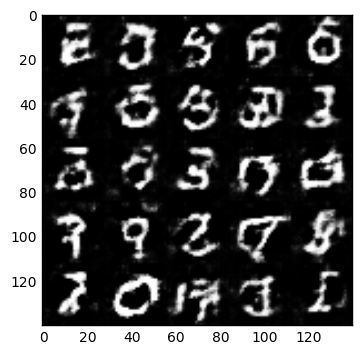

901 Epoch 1/2... Discriminator Loss: 1.4231... Generator Loss: 0.5498
902 Epoch 1/2... Discriminator Loss: 1.1455... Generator Loss: 1.0635
903 Epoch 1/2... Discriminator Loss: 1.2049... Generator Loss: 1.1191
904 Epoch 1/2... Discriminator Loss: 1.3035... Generator Loss: 0.6119
905 Epoch 1/2... Discriminator Loss: 1.2540... Generator Loss: 1.0681
906 Epoch 1/2... Discriminator Loss: 1.2183... Generator Loss: 0.6951
907 Epoch 1/2... Discriminator Loss: 1.2009... Generator Loss: 0.7708
908 Epoch 1/2... Discriminator Loss: 1.2329... Generator Loss: 1.0339
909 Epoch 1/2... Discriminator Loss: 1.1769... Generator Loss: 0.8399
910 Epoch 1/2... Discriminator Loss: 1.2376... Generator Loss: 0.7103
911 Epoch 1/2... Discriminator Loss: 1.1752... Generator Loss: 1.2480
912 Epoch 1/2... Discriminator Loss: 1.3354... Generator Loss: 0.5722
913 Epoch 1/2... Discriminator Loss: 1.2734... Generator Loss: 0.7418
914 Epoch 1/2... Discriminator Loss: 1.2753... Generator Loss: 1.2237
915 Epoch 1/2... Dis

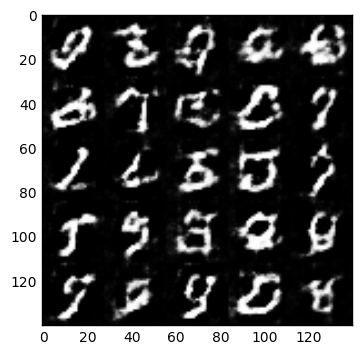

1001 Epoch 1/2... Discriminator Loss: 1.3268... Generator Loss: 0.6434
1002 Epoch 1/2... Discriminator Loss: 1.3152... Generator Loss: 1.2935
1003 Epoch 1/2... Discriminator Loss: 1.3155... Generator Loss: 0.5855
1004 Epoch 1/2... Discriminator Loss: 1.3001... Generator Loss: 0.8731
1005 Epoch 1/2... Discriminator Loss: 1.2981... Generator Loss: 0.8844
1006 Epoch 1/2... Discriminator Loss: 1.3406... Generator Loss: 0.6713
1007 Epoch 1/2... Discriminator Loss: 1.3229... Generator Loss: 1.1863
1008 Epoch 1/2... Discriminator Loss: 1.3534... Generator Loss: 0.5643
1009 Epoch 1/2... Discriminator Loss: 1.1722... Generator Loss: 0.8908
1010 Epoch 1/2... Discriminator Loss: 1.1564... Generator Loss: 1.1500
1011 Epoch 1/2... Discriminator Loss: 1.1561... Generator Loss: 0.8417
1012 Epoch 1/2... Discriminator Loss: 1.3058... Generator Loss: 0.6089
1013 Epoch 1/2... Discriminator Loss: 1.1828... Generator Loss: 1.1979
1014 Epoch 1/2... Discriminator Loss: 1.0624... Generator Loss: 0.8682
1015 E

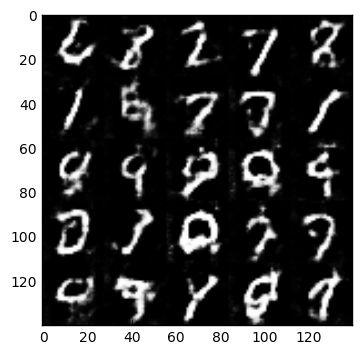

1101 Epoch 1/2... Discriminator Loss: 1.2597... Generator Loss: 0.8555
1102 Epoch 1/2... Discriminator Loss: 1.3454... Generator Loss: 0.7346
1103 Epoch 1/2... Discriminator Loss: 1.1864... Generator Loss: 0.8462
1104 Epoch 1/2... Discriminator Loss: 1.0994... Generator Loss: 0.9237
1105 Epoch 1/2... Discriminator Loss: 1.3007... Generator Loss: 0.6032
1106 Epoch 1/2... Discriminator Loss: 1.2315... Generator Loss: 1.2506
1107 Epoch 1/2... Discriminator Loss: 1.3509... Generator Loss: 0.6057
1108 Epoch 1/2... Discriminator Loss: 1.2037... Generator Loss: 0.8716
1109 Epoch 1/2... Discriminator Loss: 1.3987... Generator Loss: 0.6441
1110 Epoch 1/2... Discriminator Loss: 1.2821... Generator Loss: 0.7428
1111 Epoch 1/2... Discriminator Loss: 1.2379... Generator Loss: 1.0675
1112 Epoch 1/2... Discriminator Loss: 1.3802... Generator Loss: 0.5865
1113 Epoch 1/2... Discriminator Loss: 1.2684... Generator Loss: 0.7618
1114 Epoch 1/2... Discriminator Loss: 1.0925... Generator Loss: 1.1677
1115 E

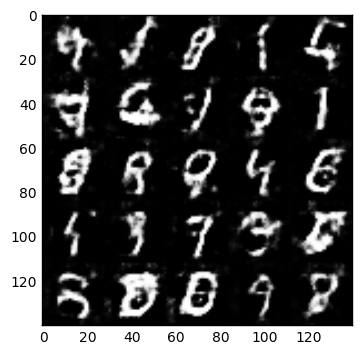

1201 Epoch 1/2... Discriminator Loss: 1.3545... Generator Loss: 0.9591
1202 Epoch 1/2... Discriminator Loss: 1.5205... Generator Loss: 0.4297
1203 Epoch 1/2... Discriminator Loss: 1.3504... Generator Loss: 1.1566
1204 Epoch 1/2... Discriminator Loss: 1.1597... Generator Loss: 0.7659
1205 Epoch 1/2... Discriminator Loss: 1.2820... Generator Loss: 0.6362
1206 Epoch 1/2... Discriminator Loss: 1.3200... Generator Loss: 0.9838
1207 Epoch 1/2... Discriminator Loss: 1.4010... Generator Loss: 0.5438
1208 Epoch 1/2... Discriminator Loss: 1.1446... Generator Loss: 1.0156
1209 Epoch 1/2... Discriminator Loss: 1.1909... Generator Loss: 0.8524
1210 Epoch 1/2... Discriminator Loss: 1.3092... Generator Loss: 0.7227
1211 Epoch 1/2... Discriminator Loss: 1.2605... Generator Loss: 1.1529
1212 Epoch 1/2... Discriminator Loss: 1.3709... Generator Loss: 0.5516
1213 Epoch 1/2... Discriminator Loss: 1.1812... Generator Loss: 1.1935
1214 Epoch 1/2... Discriminator Loss: 1.5171... Generator Loss: 0.4238
1215 E

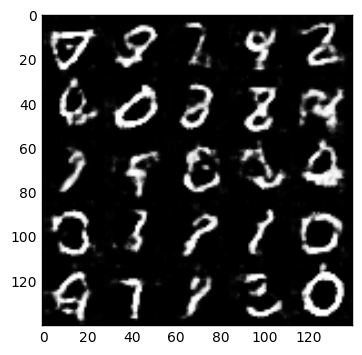

1301 Epoch 1/2... Discriminator Loss: 1.1617... Generator Loss: 0.8418
1302 Epoch 1/2... Discriminator Loss: 1.2350... Generator Loss: 0.7744
1303 Epoch 1/2... Discriminator Loss: 1.2505... Generator Loss: 0.7253
1304 Epoch 1/2... Discriminator Loss: 1.2524... Generator Loss: 0.8645
1305 Epoch 1/2... Discriminator Loss: 1.3690... Generator Loss: 0.6247
1306 Epoch 1/2... Discriminator Loss: 1.3264... Generator Loss: 0.8478
1307 Epoch 1/2... Discriminator Loss: 1.4221... Generator Loss: 0.5004
1308 Epoch 1/2... Discriminator Loss: 1.2531... Generator Loss: 1.2221
1309 Epoch 1/2... Discriminator Loss: 1.2185... Generator Loss: 0.7059
1310 Epoch 1/2... Discriminator Loss: 1.0597... Generator Loss: 0.9572
1311 Epoch 1/2... Discriminator Loss: 1.5146... Generator Loss: 0.4928
1312 Epoch 1/2... Discriminator Loss: 1.3130... Generator Loss: 0.8210
1313 Epoch 1/2... Discriminator Loss: 1.4969... Generator Loss: 0.5665
1314 Epoch 1/2... Discriminator Loss: 1.2463... Generator Loss: 0.7817
1315 E

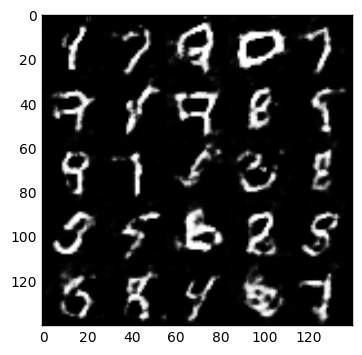

1401 Epoch 1/2... Discriminator Loss: 1.2578... Generator Loss: 1.1619
1402 Epoch 1/2... Discriminator Loss: 1.3041... Generator Loss: 0.5915
1403 Epoch 1/2... Discriminator Loss: 1.2479... Generator Loss: 0.7170
1404 Epoch 1/2... Discriminator Loss: 1.1110... Generator Loss: 0.8780
1405 Epoch 1/2... Discriminator Loss: 1.2238... Generator Loss: 0.7726
1406 Epoch 1/2... Discriminator Loss: 1.5222... Generator Loss: 0.5734
1407 Epoch 1/2... Discriminator Loss: 1.3145... Generator Loss: 0.7275
1408 Epoch 1/2... Discriminator Loss: 1.1038... Generator Loss: 0.9586
1409 Epoch 1/2... Discriminator Loss: 1.2988... Generator Loss: 0.7486
1410 Epoch 1/2... Discriminator Loss: 1.2259... Generator Loss: 0.7535
1411 Epoch 1/2... Discriminator Loss: 1.3814... Generator Loss: 0.5431
1412 Epoch 1/2... Discriminator Loss: 1.2945... Generator Loss: 1.2196
1413 Epoch 1/2... Discriminator Loss: 1.6410... Generator Loss: 0.3809
1414 Epoch 1/2... Discriminator Loss: 1.2981... Generator Loss: 1.1708
1415 E

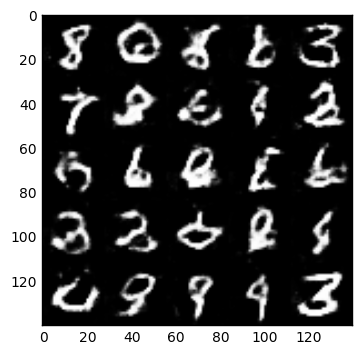

1501 Epoch 1/2... Discriminator Loss: 1.2846... Generator Loss: 0.6523
1502 Epoch 1/2... Discriminator Loss: 1.3505... Generator Loss: 0.5888
1503 Epoch 1/2... Discriminator Loss: 1.1432... Generator Loss: 1.0419
1504 Epoch 1/2... Discriminator Loss: 1.3130... Generator Loss: 0.5965
1505 Epoch 1/2... Discriminator Loss: 1.2419... Generator Loss: 0.8453
1506 Epoch 1/2... Discriminator Loss: 1.4418... Generator Loss: 0.5537
1507 Epoch 1/2... Discriminator Loss: 1.3039... Generator Loss: 0.8849
1508 Epoch 1/2... Discriminator Loss: 1.3845... Generator Loss: 0.5403
1509 Epoch 1/2... Discriminator Loss: 1.2666... Generator Loss: 1.0545
1510 Epoch 1/2... Discriminator Loss: 1.4138... Generator Loss: 0.5170
1511 Epoch 1/2... Discriminator Loss: 1.2593... Generator Loss: 1.1095
1512 Epoch 1/2... Discriminator Loss: 1.4263... Generator Loss: 0.5476
1513 Epoch 1/2... Discriminator Loss: 1.2156... Generator Loss: 1.0685
1514 Epoch 1/2... Discriminator Loss: 1.2819... Generator Loss: 0.7493
1515 E

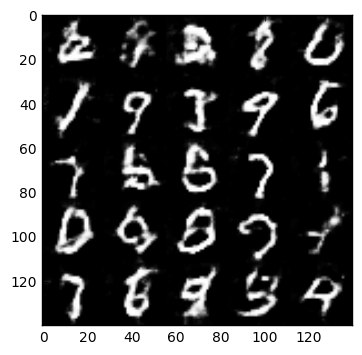

1601 Epoch 1/2... Discriminator Loss: 1.3540... Generator Loss: 0.5430
1602 Epoch 1/2... Discriminator Loss: 1.2913... Generator Loss: 0.7689
1603 Epoch 1/2... Discriminator Loss: 1.7107... Generator Loss: 0.3611
1604 Epoch 1/2... Discriminator Loss: 1.4257... Generator Loss: 1.2987
1605 Epoch 1/2... Discriminator Loss: 1.4485... Generator Loss: 0.4931
1606 Epoch 1/2... Discriminator Loss: 1.4070... Generator Loss: 1.2915
1607 Epoch 1/2... Discriminator Loss: 1.3466... Generator Loss: 0.6526
1608 Epoch 1/2... Discriminator Loss: 1.4113... Generator Loss: 0.5365
1609 Epoch 1/2... Discriminator Loss: 1.2857... Generator Loss: 1.0797
1610 Epoch 1/2... Discriminator Loss: 1.5448... Generator Loss: 0.4443
1611 Epoch 1/2... Discriminator Loss: 1.2055... Generator Loss: 1.1497
1612 Epoch 1/2... Discriminator Loss: 1.2220... Generator Loss: 0.6447
1613 Epoch 1/2... Discriminator Loss: 1.3940... Generator Loss: 0.6824
1614 Epoch 1/2... Discriminator Loss: 1.3173... Generator Loss: 0.8826
1615 E

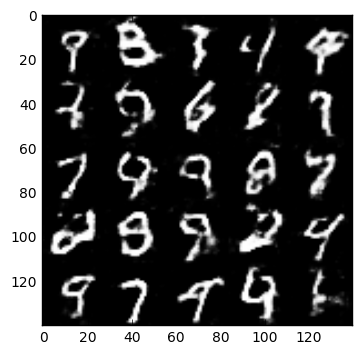

1701 Epoch 1/2... Discriminator Loss: 1.3496... Generator Loss: 0.6642
1702 Epoch 1/2... Discriminator Loss: 1.3533... Generator Loss: 0.9638
1703 Epoch 1/2... Discriminator Loss: 1.5902... Generator Loss: 0.3942
1704 Epoch 1/2... Discriminator Loss: 1.2547... Generator Loss: 1.0178
1705 Epoch 1/2... Discriminator Loss: 1.2778... Generator Loss: 0.7541
1706 Epoch 1/2... Discriminator Loss: 1.3648... Generator Loss: 0.5735
1707 Epoch 1/2... Discriminator Loss: 1.2896... Generator Loss: 0.8357
1708 Epoch 1/2... Discriminator Loss: 1.4167... Generator Loss: 0.6053
1709 Epoch 1/2... Discriminator Loss: 1.3101... Generator Loss: 0.7093
1710 Epoch 1/2... Discriminator Loss: 1.2574... Generator Loss: 0.7434
1711 Epoch 1/2... Discriminator Loss: 1.3215... Generator Loss: 0.8053
1712 Epoch 1/2... Discriminator Loss: 1.3991... Generator Loss: 0.4851
1713 Epoch 1/2... Discriminator Loss: 1.4321... Generator Loss: 1.2770
1714 Epoch 1/2... Discriminator Loss: 1.7032... Generator Loss: 0.3387
1715 E

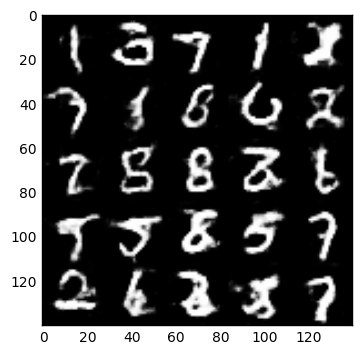

1801 Epoch 1/2... Discriminator Loss: 1.3996... Generator Loss: 0.5736
1802 Epoch 1/2... Discriminator Loss: 1.2478... Generator Loss: 0.9359
1803 Epoch 1/2... Discriminator Loss: 1.2397... Generator Loss: 0.6197
1804 Epoch 1/2... Discriminator Loss: 1.2422... Generator Loss: 0.7930
1805 Epoch 1/2... Discriminator Loss: 1.2742... Generator Loss: 0.6700
1806 Epoch 1/2... Discriminator Loss: 1.2809... Generator Loss: 0.8179
1807 Epoch 1/2... Discriminator Loss: 1.2274... Generator Loss: 0.7865
1808 Epoch 1/2... Discriminator Loss: 1.4890... Generator Loss: 0.4687
1809 Epoch 1/2... Discriminator Loss: 1.3314... Generator Loss: 1.1388
1810 Epoch 1/2... Discriminator Loss: 1.6347... Generator Loss: 0.3594
1811 Epoch 1/2... Discriminator Loss: 1.2345... Generator Loss: 1.2065
1812 Epoch 1/2... Discriminator Loss: 1.4761... Generator Loss: 0.5118
1813 Epoch 1/2... Discriminator Loss: 1.3790... Generator Loss: 0.6170
1814 Epoch 1/2... Discriminator Loss: 1.2399... Generator Loss: 0.9334
1815 E

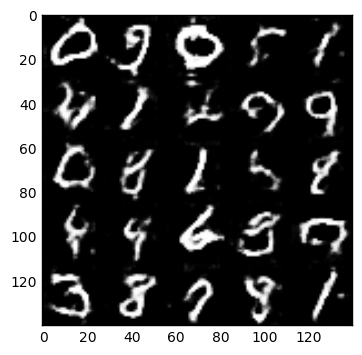

1901 Epoch 2/2... Discriminator Loss: 1.2937... Generator Loss: 1.0485
1902 Epoch 2/2... Discriminator Loss: 1.4755... Generator Loss: 0.5029
1903 Epoch 2/2... Discriminator Loss: 1.2515... Generator Loss: 0.6941
1904 Epoch 2/2... Discriminator Loss: 1.4374... Generator Loss: 0.8172
1905 Epoch 2/2... Discriminator Loss: 1.4216... Generator Loss: 0.5178
1906 Epoch 2/2... Discriminator Loss: 1.1941... Generator Loss: 0.9816
1907 Epoch 2/2... Discriminator Loss: 1.4115... Generator Loss: 0.4919
1908 Epoch 2/2... Discriminator Loss: 1.3180... Generator Loss: 1.1669
1909 Epoch 2/2... Discriminator Loss: 1.3961... Generator Loss: 0.5099
1910 Epoch 2/2... Discriminator Loss: 1.1633... Generator Loss: 0.9533
1911 Epoch 2/2... Discriminator Loss: 1.2550... Generator Loss: 0.8027
1912 Epoch 2/2... Discriminator Loss: 1.5127... Generator Loss: 0.4741
1913 Epoch 2/2... Discriminator Loss: 1.1671... Generator Loss: 0.8766
1914 Epoch 2/2... Discriminator Loss: 1.1589... Generator Loss: 0.8710
1915 E

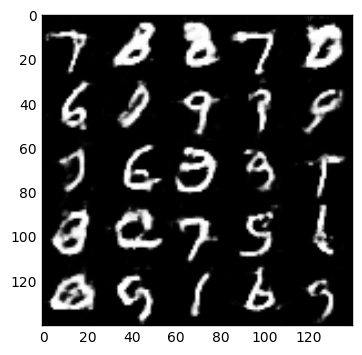

2001 Epoch 2/2... Discriminator Loss: 1.1331... Generator Loss: 1.1340
2002 Epoch 2/2... Discriminator Loss: 1.1605... Generator Loss: 0.7669
2003 Epoch 2/2... Discriminator Loss: 1.2234... Generator Loss: 0.6938
2004 Epoch 2/2... Discriminator Loss: 1.4217... Generator Loss: 0.5108
2005 Epoch 2/2... Discriminator Loss: 1.2054... Generator Loss: 0.8488
2006 Epoch 2/2... Discriminator Loss: 1.3853... Generator Loss: 0.5548
2007 Epoch 2/2... Discriminator Loss: 1.2239... Generator Loss: 0.7436
2008 Epoch 2/2... Discriminator Loss: 1.1977... Generator Loss: 0.8948
2009 Epoch 2/2... Discriminator Loss: 1.3673... Generator Loss: 0.5805
2010 Epoch 2/2... Discriminator Loss: 1.3776... Generator Loss: 0.6755
2011 Epoch 2/2... Discriminator Loss: 1.2585... Generator Loss: 0.7627
2012 Epoch 2/2... Discriminator Loss: 1.3388... Generator Loss: 0.5829
2013 Epoch 2/2... Discriminator Loss: 1.3630... Generator Loss: 0.5189
2014 Epoch 2/2... Discriminator Loss: 1.1305... Generator Loss: 1.2439
2015 E

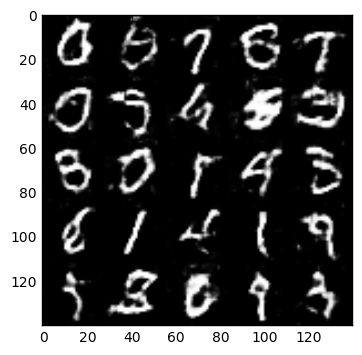

2101 Epoch 2/2... Discriminator Loss: 1.2794... Generator Loss: 0.8027
2102 Epoch 2/2... Discriminator Loss: 1.5188... Generator Loss: 0.4043
2103 Epoch 2/2... Discriminator Loss: 1.1528... Generator Loss: 0.9450
2104 Epoch 2/2... Discriminator Loss: 1.1869... Generator Loss: 0.7292
2105 Epoch 2/2... Discriminator Loss: 1.2577... Generator Loss: 0.7994
2106 Epoch 2/2... Discriminator Loss: 1.2845... Generator Loss: 0.5987
2107 Epoch 2/2... Discriminator Loss: 1.3430... Generator Loss: 0.7697
2108 Epoch 2/2... Discriminator Loss: 1.3332... Generator Loss: 0.5735
2109 Epoch 2/2... Discriminator Loss: 1.3833... Generator Loss: 0.5870
2110 Epoch 2/2... Discriminator Loss: 1.1287... Generator Loss: 0.9005
2111 Epoch 2/2... Discriminator Loss: 1.3271... Generator Loss: 0.5458
2112 Epoch 2/2... Discriminator Loss: 1.3586... Generator Loss: 0.5686
2113 Epoch 2/2... Discriminator Loss: 1.3229... Generator Loss: 0.5761
2114 Epoch 2/2... Discriminator Loss: 1.3276... Generator Loss: 1.6521
2115 E

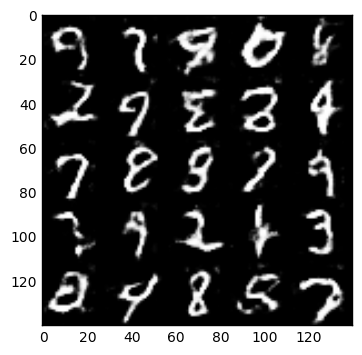

2201 Epoch 2/2... Discriminator Loss: 1.3803... Generator Loss: 0.5289
2202 Epoch 2/2... Discriminator Loss: 1.1450... Generator Loss: 0.8564
2203 Epoch 2/2... Discriminator Loss: 1.3071... Generator Loss: 0.6223
2204 Epoch 2/2... Discriminator Loss: 1.3284... Generator Loss: 0.5840
2205 Epoch 2/2... Discriminator Loss: 1.1324... Generator Loss: 0.8179
2206 Epoch 2/2... Discriminator Loss: 1.3681... Generator Loss: 0.5589
2207 Epoch 2/2... Discriminator Loss: 1.1692... Generator Loss: 1.1195
2208 Epoch 2/2... Discriminator Loss: 1.5693... Generator Loss: 0.4012
2209 Epoch 2/2... Discriminator Loss: 1.3464... Generator Loss: 0.7998
2210 Epoch 2/2... Discriminator Loss: 1.3230... Generator Loss: 0.7429
2211 Epoch 2/2... Discriminator Loss: 1.4618... Generator Loss: 0.4798
2212 Epoch 2/2... Discriminator Loss: 1.2470... Generator Loss: 0.6719
2213 Epoch 2/2... Discriminator Loss: 1.2400... Generator Loss: 0.9948
2214 Epoch 2/2... Discriminator Loss: 1.7921... Generator Loss: 0.3283
2215 E

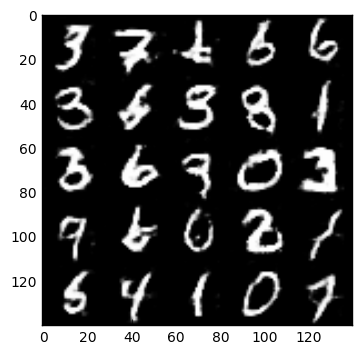

2301 Epoch 2/2... Discriminator Loss: 1.1340... Generator Loss: 1.0762
2302 Epoch 2/2... Discriminator Loss: 1.6071... Generator Loss: 0.3675
2303 Epoch 2/2... Discriminator Loss: 1.1879... Generator Loss: 1.0368
2304 Epoch 2/2... Discriminator Loss: 1.5500... Generator Loss: 0.4306
2305 Epoch 2/2... Discriminator Loss: 1.2167... Generator Loss: 0.8047
2306 Epoch 2/2... Discriminator Loss: 1.1084... Generator Loss: 1.0034
2307 Epoch 2/2... Discriminator Loss: 1.3829... Generator Loss: 0.4971
2308 Epoch 2/2... Discriminator Loss: 1.1147... Generator Loss: 0.8483
2309 Epoch 2/2... Discriminator Loss: 1.1662... Generator Loss: 0.7182
2310 Epoch 2/2... Discriminator Loss: 1.2030... Generator Loss: 0.6814
2311 Epoch 2/2... Discriminator Loss: 1.2584... Generator Loss: 0.7289
2312 Epoch 2/2... Discriminator Loss: 1.2285... Generator Loss: 0.6292
2313 Epoch 2/2... Discriminator Loss: 1.2101... Generator Loss: 0.9645
2314 Epoch 2/2... Discriminator Loss: 1.2068... Generator Loss: 0.6396
2315 E

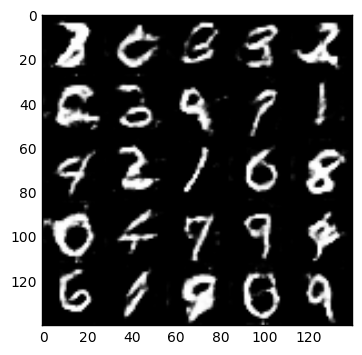

2401 Epoch 2/2... Discriminator Loss: 1.2365... Generator Loss: 0.6688
2402 Epoch 2/2... Discriminator Loss: 1.2556... Generator Loss: 0.6310
2403 Epoch 2/2... Discriminator Loss: 1.3815... Generator Loss: 0.5833
2404 Epoch 2/2... Discriminator Loss: 1.0545... Generator Loss: 1.1224
2405 Epoch 2/2... Discriminator Loss: 1.6722... Generator Loss: 0.3514
2406 Epoch 2/2... Discriminator Loss: 1.0975... Generator Loss: 1.4084
2407 Epoch 2/2... Discriminator Loss: 1.0649... Generator Loss: 1.0217
2408 Epoch 2/2... Discriminator Loss: 1.6824... Generator Loss: 0.3528
2409 Epoch 2/2... Discriminator Loss: 1.1471... Generator Loss: 1.0715
2410 Epoch 2/2... Discriminator Loss: 1.3345... Generator Loss: 0.6121
2411 Epoch 2/2... Discriminator Loss: 1.4777... Generator Loss: 0.4277
2412 Epoch 2/2... Discriminator Loss: 1.3044... Generator Loss: 0.9718
2413 Epoch 2/2... Discriminator Loss: 1.3232... Generator Loss: 0.5782
2414 Epoch 2/2... Discriminator Loss: 1.1207... Generator Loss: 0.7780
2415 E

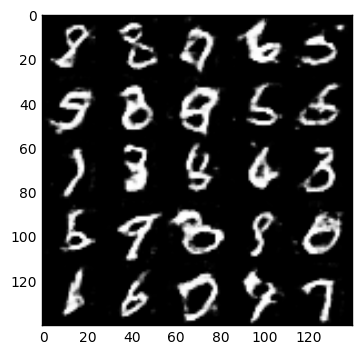

2501 Epoch 2/2... Discriminator Loss: 1.2521... Generator Loss: 0.6527
2502 Epoch 2/2... Discriminator Loss: 1.3837... Generator Loss: 0.5084
2503 Epoch 2/2... Discriminator Loss: 1.2385... Generator Loss: 1.0235
2504 Epoch 2/2... Discriminator Loss: 1.5149... Generator Loss: 0.4487
2505 Epoch 2/2... Discriminator Loss: 1.1424... Generator Loss: 0.7372
2506 Epoch 2/2... Discriminator Loss: 1.2567... Generator Loss: 0.6833
2507 Epoch 2/2... Discriminator Loss: 1.2412... Generator Loss: 0.6608
2508 Epoch 2/2... Discriminator Loss: 1.0238... Generator Loss: 1.0777
2509 Epoch 2/2... Discriminator Loss: 1.7533... Generator Loss: 0.3217
2510 Epoch 2/2... Discriminator Loss: 1.0445... Generator Loss: 1.2116
2511 Epoch 2/2... Discriminator Loss: 1.3734... Generator Loss: 0.5371
2512 Epoch 2/2... Discriminator Loss: 1.2978... Generator Loss: 0.5865
2513 Epoch 2/2... Discriminator Loss: 1.1312... Generator Loss: 1.2576
2514 Epoch 2/2... Discriminator Loss: 1.4009... Generator Loss: 0.4814
2515 E

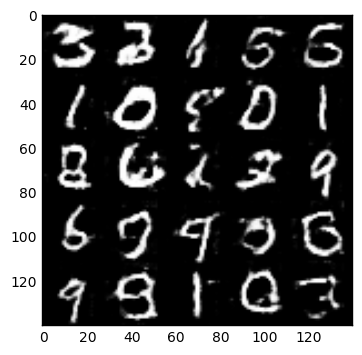

2601 Epoch 2/2... Discriminator Loss: 1.4124... Generator Loss: 0.5374
2602 Epoch 2/2... Discriminator Loss: 1.2371... Generator Loss: 0.7255
2603 Epoch 2/2... Discriminator Loss: 1.3660... Generator Loss: 0.6359
2604 Epoch 2/2... Discriminator Loss: 1.0915... Generator Loss: 0.7404
2605 Epoch 2/2... Discriminator Loss: 1.3971... Generator Loss: 0.5590
2606 Epoch 2/2... Discriminator Loss: 1.1504... Generator Loss: 1.0006
2607 Epoch 2/2... Discriminator Loss: 1.6553... Generator Loss: 0.3471
2608 Epoch 2/2... Discriminator Loss: 1.2615... Generator Loss: 0.8548
2609 Epoch 2/2... Discriminator Loss: 1.2544... Generator Loss: 0.7845
2610 Epoch 2/2... Discriminator Loss: 1.1243... Generator Loss: 0.9401
2611 Epoch 2/2... Discriminator Loss: 1.7258... Generator Loss: 0.3341
2612 Epoch 2/2... Discriminator Loss: 1.1813... Generator Loss: 1.2764
2613 Epoch 2/2... Discriminator Loss: 1.5978... Generator Loss: 0.4041
2614 Epoch 2/2... Discriminator Loss: 1.1785... Generator Loss: 0.7427
2615 E

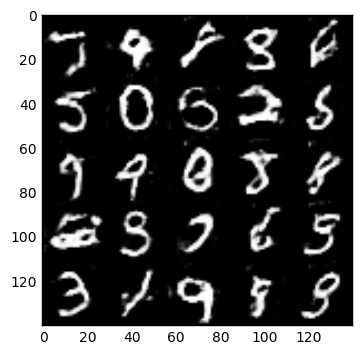

2701 Epoch 2/2... Discriminator Loss: 1.3101... Generator Loss: 0.7167
2702 Epoch 2/2... Discriminator Loss: 1.3543... Generator Loss: 0.5460
2703 Epoch 2/2... Discriminator Loss: 1.1806... Generator Loss: 0.8391
2704 Epoch 2/2... Discriminator Loss: 1.6309... Generator Loss: 0.3427
2705 Epoch 2/2... Discriminator Loss: 1.5335... Generator Loss: 0.4235
2706 Epoch 2/2... Discriminator Loss: 1.5662... Generator Loss: 0.4486
2707 Epoch 2/2... Discriminator Loss: 1.0422... Generator Loss: 0.9757
2708 Epoch 2/2... Discriminator Loss: 1.2652... Generator Loss: 0.7193
2709 Epoch 2/2... Discriminator Loss: 1.9882... Generator Loss: 0.2463
2710 Epoch 2/2... Discriminator Loss: 1.3575... Generator Loss: 1.3653
2711 Epoch 2/2... Discriminator Loss: 1.5431... Generator Loss: 0.4292
2712 Epoch 2/2... Discriminator Loss: 1.3928... Generator Loss: 0.5821
2713 Epoch 2/2... Discriminator Loss: 1.3092... Generator Loss: 0.6532
2714 Epoch 2/2... Discriminator Loss: 1.0976... Generator Loss: 0.8878
2715 E

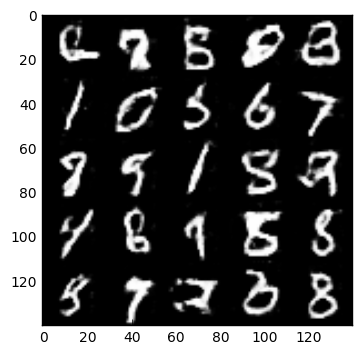

2801 Epoch 2/2... Discriminator Loss: 1.3057... Generator Loss: 0.6941
2802 Epoch 2/2... Discriminator Loss: 1.1765... Generator Loss: 0.8386
2803 Epoch 2/2... Discriminator Loss: 1.3787... Generator Loss: 0.5023
2804 Epoch 2/2... Discriminator Loss: 1.2382... Generator Loss: 0.6538
2805 Epoch 2/2... Discriminator Loss: 1.1679... Generator Loss: 0.7311
2806 Epoch 2/2... Discriminator Loss: 1.2246... Generator Loss: 0.6723
2807 Epoch 2/2... Discriminator Loss: 1.1640... Generator Loss: 0.7187
2808 Epoch 2/2... Discriminator Loss: 1.5338... Generator Loss: 0.4528
2809 Epoch 2/2... Discriminator Loss: 1.3737... Generator Loss: 0.5627
2810 Epoch 2/2... Discriminator Loss: 1.3966... Generator Loss: 0.5470
2811 Epoch 2/2... Discriminator Loss: 1.7156... Generator Loss: 0.3388
2812 Epoch 2/2... Discriminator Loss: 1.4424... Generator Loss: 0.8252
2813 Epoch 2/2... Discriminator Loss: 1.1733... Generator Loss: 0.6636
2814 Epoch 2/2... Discriminator Loss: 1.4373... Generator Loss: 0.4718
2815 E

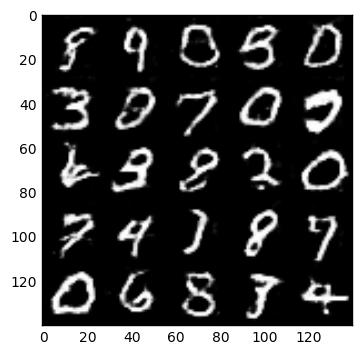

2901 Epoch 2/2... Discriminator Loss: 1.2624... Generator Loss: 0.7308
2902 Epoch 2/2... Discriminator Loss: 1.2943... Generator Loss: 0.5675
2903 Epoch 2/2... Discriminator Loss: 1.2820... Generator Loss: 0.7128
2904 Epoch 2/2... Discriminator Loss: 1.2293... Generator Loss: 0.6308
2905 Epoch 2/2... Discriminator Loss: 1.5864... Generator Loss: 0.4068
2906 Epoch 2/2... Discriminator Loss: 1.2906... Generator Loss: 0.6925
2907 Epoch 2/2... Discriminator Loss: 1.5407... Generator Loss: 0.4263
2908 Epoch 2/2... Discriminator Loss: 1.1544... Generator Loss: 1.2207
2909 Epoch 2/2... Discriminator Loss: 1.3273... Generator Loss: 0.5062
2910 Epoch 2/2... Discriminator Loss: 1.2192... Generator Loss: 0.6226
2911 Epoch 2/2... Discriminator Loss: 1.1987... Generator Loss: 0.8790
2912 Epoch 2/2... Discriminator Loss: 1.7466... Generator Loss: 0.3221
2913 Epoch 2/2... Discriminator Loss: 1.0053... Generator Loss: 1.7528
2914 Epoch 2/2... Discriminator Loss: 1.4015... Generator Loss: 0.4706
2915 E

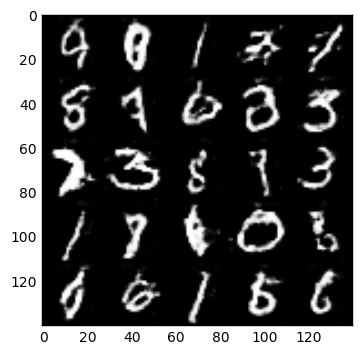

3001 Epoch 2/2... Discriminator Loss: 2.6946... Generator Loss: 0.1305
3002 Epoch 2/2... Discriminator Loss: 1.2065... Generator Loss: 0.8928
3003 Epoch 2/2... Discriminator Loss: 1.2296... Generator Loss: 1.1872
3004 Epoch 2/2... Discriminator Loss: 1.3249... Generator Loss: 0.5432
3005 Epoch 2/2... Discriminator Loss: 1.4855... Generator Loss: 0.5327
3006 Epoch 2/2... Discriminator Loss: 1.2888... Generator Loss: 1.0041
3007 Epoch 2/2... Discriminator Loss: 1.6777... Generator Loss: 0.3645
3008 Epoch 2/2... Discriminator Loss: 0.9745... Generator Loss: 1.2881
3009 Epoch 2/2... Discriminator Loss: 1.1331... Generator Loss: 0.7635
3010 Epoch 2/2... Discriminator Loss: 1.1022... Generator Loss: 0.7423
3011 Epoch 2/2... Discriminator Loss: 1.3760... Generator Loss: 0.5198
3012 Epoch 2/2... Discriminator Loss: 1.2259... Generator Loss: 1.0195
3013 Epoch 2/2... Discriminator Loss: 1.3148... Generator Loss: 0.5875
3014 Epoch 2/2... Discriminator Loss: 1.3916... Generator Loss: 0.4822
3015 E

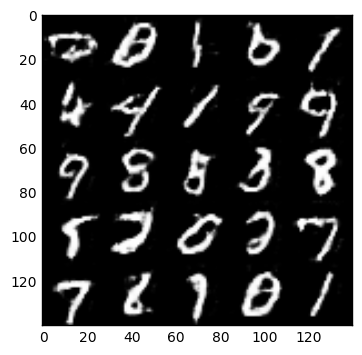

3101 Epoch 2/2... Discriminator Loss: 1.3853... Generator Loss: 0.5557
3102 Epoch 2/2... Discriminator Loss: 1.0516... Generator Loss: 0.8451
3103 Epoch 2/2... Discriminator Loss: 1.6694... Generator Loss: 0.3591
3104 Epoch 2/2... Discriminator Loss: 1.1915... Generator Loss: 1.1736
3105 Epoch 2/2... Discriminator Loss: 1.2952... Generator Loss: 0.5657
3106 Epoch 2/2... Discriminator Loss: 1.3148... Generator Loss: 0.5433
3107 Epoch 2/2... Discriminator Loss: 1.0964... Generator Loss: 0.8220
3108 Epoch 2/2... Discriminator Loss: 1.3823... Generator Loss: 0.5195
3109 Epoch 2/2... Discriminator Loss: 1.1446... Generator Loss: 0.6972
3110 Epoch 2/2... Discriminator Loss: 1.1433... Generator Loss: 0.8306
3111 Epoch 2/2... Discriminator Loss: 1.1985... Generator Loss: 0.6828
3112 Epoch 2/2... Discriminator Loss: 1.0379... Generator Loss: 0.9900
3113 Epoch 2/2... Discriminator Loss: 1.3303... Generator Loss: 0.5884
3114 Epoch 2/2... Discriminator Loss: 1.2726... Generator Loss: 0.6083
3115 E

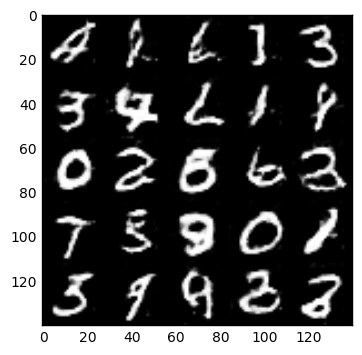

3201 Epoch 2/2... Discriminator Loss: 1.1001... Generator Loss: 1.0095
3202 Epoch 2/2... Discriminator Loss: 1.5363... Generator Loss: 0.4152
3203 Epoch 2/2... Discriminator Loss: 1.0375... Generator Loss: 0.9315
3204 Epoch 2/2... Discriminator Loss: 1.0174... Generator Loss: 1.0138
3205 Epoch 2/2... Discriminator Loss: 1.2842... Generator Loss: 0.5836
3206 Epoch 2/2... Discriminator Loss: 1.4672... Generator Loss: 0.4971
3207 Epoch 2/2... Discriminator Loss: 1.3552... Generator Loss: 0.6649
3208 Epoch 2/2... Discriminator Loss: 1.3002... Generator Loss: 0.5535
3209 Epoch 2/2... Discriminator Loss: 1.2668... Generator Loss: 0.6561
3210 Epoch 2/2... Discriminator Loss: 1.1557... Generator Loss: 0.8341
3211 Epoch 2/2... Discriminator Loss: 1.4242... Generator Loss: 0.4766
3212 Epoch 2/2... Discriminator Loss: 1.0603... Generator Loss: 0.7867
3213 Epoch 2/2... Discriminator Loss: 1.2152... Generator Loss: 1.1265
3214 Epoch 2/2... Discriminator Loss: 1.7676... Generator Loss: 0.3407
3215 E

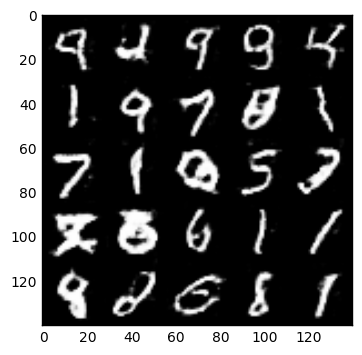

3301 Epoch 2/2... Discriminator Loss: 1.2408... Generator Loss: 0.6162
3302 Epoch 2/2... Discriminator Loss: 1.1380... Generator Loss: 0.8333
3303 Epoch 2/2... Discriminator Loss: 1.2814... Generator Loss: 0.6230
3304 Epoch 2/2... Discriminator Loss: 1.1712... Generator Loss: 0.7646
3305 Epoch 2/2... Discriminator Loss: 1.0523... Generator Loss: 0.9612
3306 Epoch 2/2... Discriminator Loss: 1.0822... Generator Loss: 0.7809
3307 Epoch 2/2... Discriminator Loss: 1.4758... Generator Loss: 0.4820
3308 Epoch 2/2... Discriminator Loss: 1.4350... Generator Loss: 0.5272
3309 Epoch 2/2... Discriminator Loss: 1.1987... Generator Loss: 0.9402
3310 Epoch 2/2... Discriminator Loss: 1.3048... Generator Loss: 0.5522
3311 Epoch 2/2... Discriminator Loss: 1.0987... Generator Loss: 0.9191
3312 Epoch 2/2... Discriminator Loss: 1.6537... Generator Loss: 0.3598
3313 Epoch 2/2... Discriminator Loss: 1.0022... Generator Loss: 1.1303
3314 Epoch 2/2... Discriminator Loss: 1.3544... Generator Loss: 0.5436
3315 E

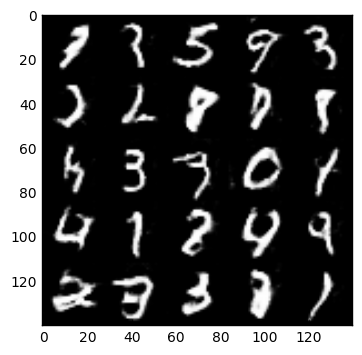

3401 Epoch 2/2... Discriminator Loss: 1.2718... Generator Loss: 0.5877
3402 Epoch 2/2... Discriminator Loss: 1.1418... Generator Loss: 0.7285
3403 Epoch 2/2... Discriminator Loss: 1.1739... Generator Loss: 0.7671
3404 Epoch 2/2... Discriminator Loss: 1.2825... Generator Loss: 0.5492
3405 Epoch 2/2... Discriminator Loss: 1.1672... Generator Loss: 0.7110
3406 Epoch 2/2... Discriminator Loss: 1.0727... Generator Loss: 0.9799
3407 Epoch 2/2... Discriminator Loss: 0.9121... Generator Loss: 1.0690
3408 Epoch 2/2... Discriminator Loss: 1.1883... Generator Loss: 0.6718
3409 Epoch 2/2... Discriminator Loss: 1.1578... Generator Loss: 0.6446
3410 Epoch 2/2... Discriminator Loss: 1.3146... Generator Loss: 0.5812
3411 Epoch 2/2... Discriminator Loss: 1.0951... Generator Loss: 1.2569
3412 Epoch 2/2... Discriminator Loss: 1.7924... Generator Loss: 0.3442
3413 Epoch 2/2... Discriminator Loss: 0.9300... Generator Loss: 1.0989
3414 Epoch 2/2... Discriminator Loss: 1.4131... Generator Loss: 0.4949
3415 E

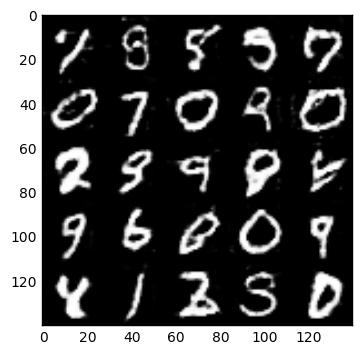

3501 Epoch 2/2... Discriminator Loss: 1.0315... Generator Loss: 1.0455
3502 Epoch 2/2... Discriminator Loss: 1.3332... Generator Loss: 0.5617
3503 Epoch 2/2... Discriminator Loss: 1.5028... Generator Loss: 0.4996
3504 Epoch 2/2... Discriminator Loss: 1.2887... Generator Loss: 0.6512
3505 Epoch 2/2... Discriminator Loss: 1.2964... Generator Loss: 0.6675
3506 Epoch 2/2... Discriminator Loss: 1.1515... Generator Loss: 0.7410
3507 Epoch 2/2... Discriminator Loss: 2.2215... Generator Loss: 0.2096
3508 Epoch 2/2... Discriminator Loss: 1.1117... Generator Loss: 1.2477
3509 Epoch 2/2... Discriminator Loss: 1.2189... Generator Loss: 0.6738
3510 Epoch 2/2... Discriminator Loss: 1.4068... Generator Loss: 0.4812
3511 Epoch 2/2... Discriminator Loss: 1.1468... Generator Loss: 0.7320
3512 Epoch 2/2... Discriminator Loss: 1.1613... Generator Loss: 0.8391
3513 Epoch 2/2... Discriminator Loss: 1.1773... Generator Loss: 0.6467
3514 Epoch 2/2... Discriminator Loss: 1.1385... Generator Loss: 0.7183
3515 E

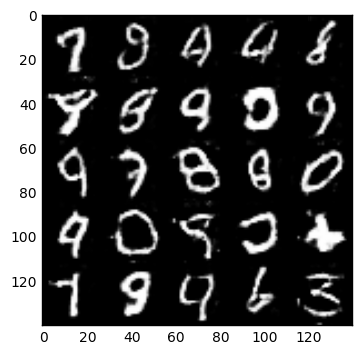

3601 Epoch 2/2... Discriminator Loss: 1.0274... Generator Loss: 0.8418
3602 Epoch 2/2... Discriminator Loss: 1.6266... Generator Loss: 0.3720
3603 Epoch 2/2... Discriminator Loss: 1.0199... Generator Loss: 1.1327
3604 Epoch 2/2... Discriminator Loss: 1.3748... Generator Loss: 0.5417
3605 Epoch 2/2... Discriminator Loss: 1.1834... Generator Loss: 0.6641
3606 Epoch 2/2... Discriminator Loss: 0.9523... Generator Loss: 1.0813
3607 Epoch 2/2... Discriminator Loss: 1.1370... Generator Loss: 0.7314
3608 Epoch 2/2... Discriminator Loss: 1.5712... Generator Loss: 0.4033
3609 Epoch 2/2... Discriminator Loss: 0.9189... Generator Loss: 1.1536
3610 Epoch 2/2... Discriminator Loss: 1.1063... Generator Loss: 0.8765
3611 Epoch 2/2... Discriminator Loss: 1.4866... Generator Loss: 0.4522
3612 Epoch 2/2... Discriminator Loss: 1.1102... Generator Loss: 0.7196
3613 Epoch 2/2... Discriminator Loss: 1.2567... Generator Loss: 0.6000
3614 Epoch 2/2... Discriminator Loss: 0.9463... Generator Loss: 1.1005
3615 E

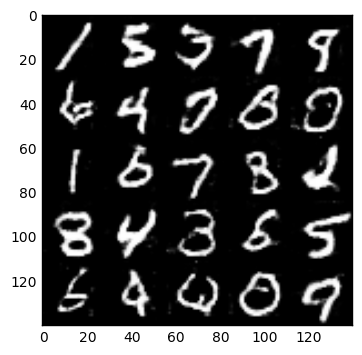

3701 Epoch 2/2... Discriminator Loss: 1.0358... Generator Loss: 0.9116
3702 Epoch 2/2... Discriminator Loss: 1.4484... Generator Loss: 0.4806
3703 Epoch 2/2... Discriminator Loss: 1.1501... Generator Loss: 0.7661
3704 Epoch 2/2... Discriminator Loss: 1.1499... Generator Loss: 0.8222
3705 Epoch 2/2... Discriminator Loss: 1.9304... Generator Loss: 0.2983
3706 Epoch 2/2... Discriminator Loss: 1.0068... Generator Loss: 1.0761
3707 Epoch 2/2... Discriminator Loss: 1.0713... Generator Loss: 0.8461
3708 Epoch 2/2... Discriminator Loss: 1.5171... Generator Loss: 0.4211
3709 Epoch 2/2... Discriminator Loss: 1.2677... Generator Loss: 0.6649
3710 Epoch 2/2... Discriminator Loss: 1.2537... Generator Loss: 0.7523
3711 Epoch 2/2... Discriminator Loss: 1.3805... Generator Loss: 0.5653
3712 Epoch 2/2... Discriminator Loss: 1.1926... Generator Loss: 0.8672
3713 Epoch 2/2... Discriminator Loss: 1.3449... Generator Loss: 0.5310
3714 Epoch 2/2... Discriminator Loss: 1.3625... Generator Loss: 0.5266
3715 E

In [12]:
batch_size = 32
z_dim = 100
learning_rate = 0.0001
beta1 = 0.5

import helper

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

0 Epoch 1/1... Discriminator Loss: 7.0042... Generator Loss: 0.0015


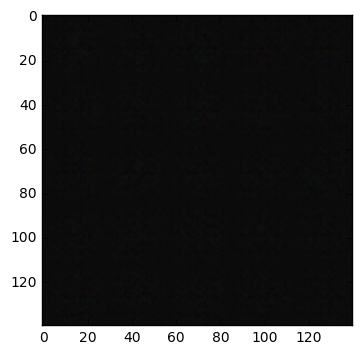

1 Epoch 1/1... Discriminator Loss: 6.2535... Generator Loss: 0.0031
2 Epoch 1/1... Discriminator Loss: 5.8563... Generator Loss: 0.0049
3 Epoch 1/1... Discriminator Loss: 5.9195... Generator Loss: 0.0054
4 Epoch 1/1... Discriminator Loss: 5.8566... Generator Loss: 0.0059
5 Epoch 1/1... Discriminator Loss: 5.6641... Generator Loss: 0.0082
6 Epoch 1/1... Discriminator Loss: 5.6074... Generator Loss: 0.0091
7 Epoch 1/1... Discriminator Loss: 5.0384... Generator Loss: 0.0137
8 Epoch 1/1... Discriminator Loss: 4.9154... Generator Loss: 0.0190
9 Epoch 1/1... Discriminator Loss: 4.6960... Generator Loss: 0.0220
10 Epoch 1/1... Discriminator Loss: 4.8127... Generator Loss: 0.0251
11 Epoch 1/1... Discriminator Loss: 4.8330... Generator Loss: 0.0255
12 Epoch 1/1... Discriminator Loss: 4.3333... Generator Loss: 0.0299
13 Epoch 1/1... Discriminator Loss: 4.3174... Generator Loss: 0.0361
14 Epoch 1/1... Discriminator Loss: 4.3064... Generator Loss: 0.0455
15 Epoch 1/1... Discriminator Loss: 3.8387.

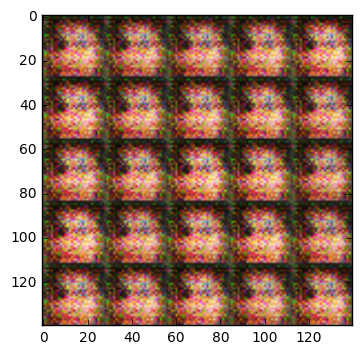

101 Epoch 1/1... Discriminator Loss: 0.9423... Generator Loss: 1.4231
102 Epoch 1/1... Discriminator Loss: 1.0003... Generator Loss: 1.4463
103 Epoch 1/1... Discriminator Loss: 0.8863... Generator Loss: 1.4047
104 Epoch 1/1... Discriminator Loss: 1.0781... Generator Loss: 1.2858
105 Epoch 1/1... Discriminator Loss: 0.9896... Generator Loss: 1.3965
106 Epoch 1/1... Discriminator Loss: 0.9875... Generator Loss: 1.4849
107 Epoch 1/1... Discriminator Loss: 1.0178... Generator Loss: 1.3370
108 Epoch 1/1... Discriminator Loss: 0.9390... Generator Loss: 1.4980
109 Epoch 1/1... Discriminator Loss: 0.9763... Generator Loss: 1.6073
110 Epoch 1/1... Discriminator Loss: 0.9419... Generator Loss: 1.6136
111 Epoch 1/1... Discriminator Loss: 1.2458... Generator Loss: 1.3610
112 Epoch 1/1... Discriminator Loss: 0.8139... Generator Loss: 1.6299
113 Epoch 1/1... Discriminator Loss: 0.7085... Generator Loss: 1.8813
114 Epoch 1/1... Discriminator Loss: 1.0991... Generator Loss: 1.6053
115 Epoch 1/1... Dis

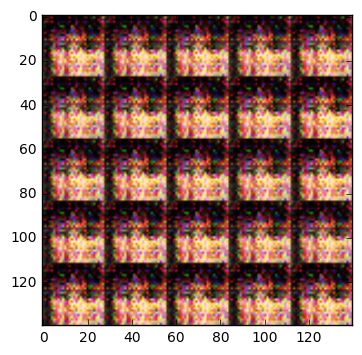

201 Epoch 1/1... Discriminator Loss: 0.6919... Generator Loss: 1.9057
202 Epoch 1/1... Discriminator Loss: 0.9521... Generator Loss: 1.6697
203 Epoch 1/1... Discriminator Loss: 0.7776... Generator Loss: 1.7917
204 Epoch 1/1... Discriminator Loss: 0.6299... Generator Loss: 1.9767
205 Epoch 1/1... Discriminator Loss: 0.6851... Generator Loss: 2.1084
206 Epoch 1/1... Discriminator Loss: 0.6168... Generator Loss: 2.1170
207 Epoch 1/1... Discriminator Loss: 0.8556... Generator Loss: 1.6854
208 Epoch 1/1... Discriminator Loss: 0.6631... Generator Loss: 1.8471
209 Epoch 1/1... Discriminator Loss: 0.9570... Generator Loss: 1.7541
210 Epoch 1/1... Discriminator Loss: 0.6188... Generator Loss: 1.9941
211 Epoch 1/1... Discriminator Loss: 0.5085... Generator Loss: 2.3289
212 Epoch 1/1... Discriminator Loss: 0.5741... Generator Loss: 2.3308
213 Epoch 1/1... Discriminator Loss: 0.5214... Generator Loss: 2.3725
214 Epoch 1/1... Discriminator Loss: 0.5680... Generator Loss: 2.3763
215 Epoch 1/1... Dis

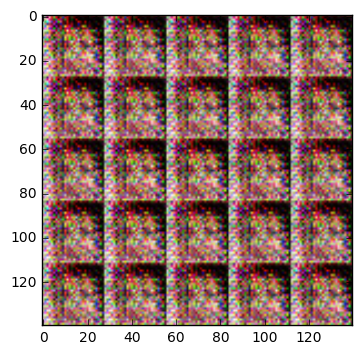

301 Epoch 1/1... Discriminator Loss: 0.5744... Generator Loss: 2.2490
302 Epoch 1/1... Discriminator Loss: 0.6237... Generator Loss: 2.1318
303 Epoch 1/1... Discriminator Loss: 0.5139... Generator Loss: 2.4599
304 Epoch 1/1... Discriminator Loss: 0.5455... Generator Loss: 2.4262
305 Epoch 1/1... Discriminator Loss: 0.5619... Generator Loss: 2.4371
306 Epoch 1/1... Discriminator Loss: 0.5781... Generator Loss: 2.3588
307 Epoch 1/1... Discriminator Loss: 0.6131... Generator Loss: 2.0662
308 Epoch 1/1... Discriminator Loss: 0.5981... Generator Loss: 2.0521
309 Epoch 1/1... Discriminator Loss: 0.6994... Generator Loss: 1.8779
310 Epoch 1/1... Discriminator Loss: 0.6547... Generator Loss: 1.7943
311 Epoch 1/1... Discriminator Loss: 0.6090... Generator Loss: 2.0075
312 Epoch 1/1... Discriminator Loss: 0.7330... Generator Loss: 1.9734
313 Epoch 1/1... Discriminator Loss: 0.6000... Generator Loss: 1.9956
314 Epoch 1/1... Discriminator Loss: 0.6352... Generator Loss: 1.9174
315 Epoch 1/1... Dis

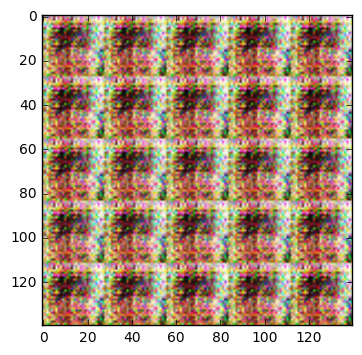

401 Epoch 1/1... Discriminator Loss: 0.4732... Generator Loss: 2.9264
402 Epoch 1/1... Discriminator Loss: 0.4209... Generator Loss: 2.9804
403 Epoch 1/1... Discriminator Loss: 0.4918... Generator Loss: 2.9155
404 Epoch 1/1... Discriminator Loss: 0.4785... Generator Loss: 2.8002
405 Epoch 1/1... Discriminator Loss: 0.5052... Generator Loss: 2.6534
406 Epoch 1/1... Discriminator Loss: 0.4478... Generator Loss: 2.7077
407 Epoch 1/1... Discriminator Loss: 0.4464... Generator Loss: 2.8660
408 Epoch 1/1... Discriminator Loss: 0.5735... Generator Loss: 2.7425
409 Epoch 1/1... Discriminator Loss: 0.4410... Generator Loss: 2.8007
410 Epoch 1/1... Discriminator Loss: 0.5103... Generator Loss: 2.8175
411 Epoch 1/1... Discriminator Loss: 0.4265... Generator Loss: 2.8604
412 Epoch 1/1... Discriminator Loss: 0.5047... Generator Loss: 2.7900
413 Epoch 1/1... Discriminator Loss: 0.5354... Generator Loss: 2.6297
414 Epoch 1/1... Discriminator Loss: 0.4474... Generator Loss: 2.6475
415 Epoch 1/1... Dis

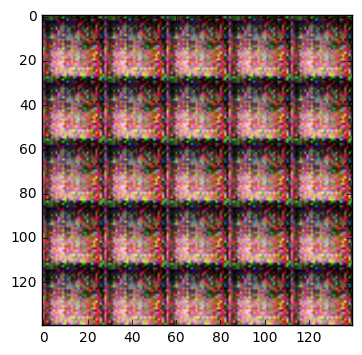

501 Epoch 1/1... Discriminator Loss: 0.4726... Generator Loss: 2.5322
502 Epoch 1/1... Discriminator Loss: 0.5483... Generator Loss: 2.2639
503 Epoch 1/1... Discriminator Loss: 0.6240... Generator Loss: 1.8159
504 Epoch 1/1... Discriminator Loss: 0.4506... Generator Loss: 2.6138
505 Epoch 1/1... Discriminator Loss: 0.5286... Generator Loss: 2.5726
506 Epoch 1/1... Discriminator Loss: 0.4756... Generator Loss: 2.6054
507 Epoch 1/1... Discriminator Loss: 0.5681... Generator Loss: 2.2829
508 Epoch 1/1... Discriminator Loss: 0.4655... Generator Loss: 2.4882
509 Epoch 1/1... Discriminator Loss: 0.5229... Generator Loss: 2.3531
510 Epoch 1/1... Discriminator Loss: 0.5839... Generator Loss: 2.2738
511 Epoch 1/1... Discriminator Loss: 0.4534... Generator Loss: 2.8006
512 Epoch 1/1... Discriminator Loss: 0.5143... Generator Loss: 2.9005
513 Epoch 1/1... Discriminator Loss: 0.4499... Generator Loss: 2.8456
514 Epoch 1/1... Discriminator Loss: 0.4004... Generator Loss: 3.1436
515 Epoch 1/1... Dis

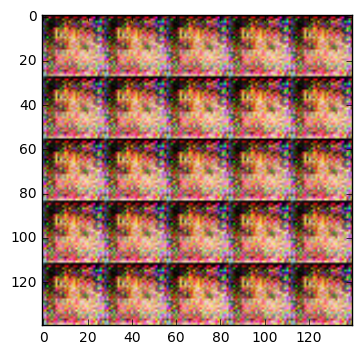

601 Epoch 1/1... Discriminator Loss: 0.5884... Generator Loss: 2.1267
602 Epoch 1/1... Discriminator Loss: 0.5082... Generator Loss: 2.5020
603 Epoch 1/1... Discriminator Loss: 0.4880... Generator Loss: 2.7423
604 Epoch 1/1... Discriminator Loss: 0.5889... Generator Loss: 2.1290
605 Epoch 1/1... Discriminator Loss: 0.4747... Generator Loss: 2.4125
606 Epoch 1/1... Discriminator Loss: 0.6321... Generator Loss: 2.2646
607 Epoch 1/1... Discriminator Loss: 0.6437... Generator Loss: 2.1796
608 Epoch 1/1... Discriminator Loss: 0.5336... Generator Loss: 2.3434
609 Epoch 1/1... Discriminator Loss: 0.5054... Generator Loss: 2.4206
610 Epoch 1/1... Discriminator Loss: 0.6845... Generator Loss: 1.6460
611 Epoch 1/1... Discriminator Loss: 0.4324... Generator Loss: 2.8137
612 Epoch 1/1... Discriminator Loss: 0.4475... Generator Loss: 3.3397
613 Epoch 1/1... Discriminator Loss: 0.5854... Generator Loss: 2.4196
614 Epoch 1/1... Discriminator Loss: 0.5108... Generator Loss: 2.1261
615 Epoch 1/1... Dis

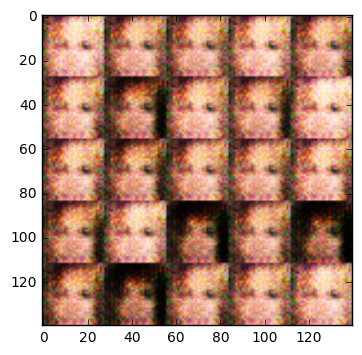

701 Epoch 1/1... Discriminator Loss: 1.2555... Generator Loss: 0.9390
702 Epoch 1/1... Discriminator Loss: 1.1696... Generator Loss: 1.0160
703 Epoch 1/1... Discriminator Loss: 1.1599... Generator Loss: 1.0239
704 Epoch 1/1... Discriminator Loss: 1.2269... Generator Loss: 0.9801
705 Epoch 1/1... Discriminator Loss: 1.3447... Generator Loss: 0.8568
706 Epoch 1/1... Discriminator Loss: 1.1884... Generator Loss: 1.0511
707 Epoch 1/1... Discriminator Loss: 1.3360... Generator Loss: 0.8322
708 Epoch 1/1... Discriminator Loss: 1.3305... Generator Loss: 0.8691
709 Epoch 1/1... Discriminator Loss: 1.1300... Generator Loss: 1.1636
710 Epoch 1/1... Discriminator Loss: 1.2756... Generator Loss: 1.0350
711 Epoch 1/1... Discriminator Loss: 1.3069... Generator Loss: 0.6970
712 Epoch 1/1... Discriminator Loss: 1.1899... Generator Loss: 1.0627
713 Epoch 1/1... Discriminator Loss: 1.2834... Generator Loss: 0.9139
714 Epoch 1/1... Discriminator Loss: 1.4626... Generator Loss: 0.6604
715 Epoch 1/1... Dis

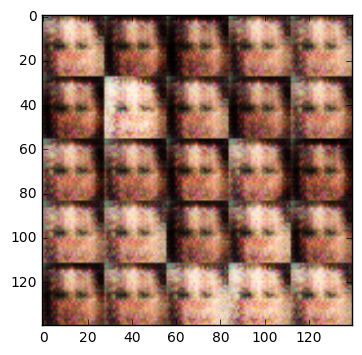

801 Epoch 1/1... Discriminator Loss: 1.3166... Generator Loss: 0.7315
802 Epoch 1/1... Discriminator Loss: 1.1162... Generator Loss: 0.9960
803 Epoch 1/1... Discriminator Loss: 1.2318... Generator Loss: 1.1482
804 Epoch 1/1... Discriminator Loss: 1.2234... Generator Loss: 1.0723
805 Epoch 1/1... Discriminator Loss: 1.2236... Generator Loss: 1.1452
806 Epoch 1/1... Discriminator Loss: 1.2537... Generator Loss: 0.9683
807 Epoch 1/1... Discriminator Loss: 1.2556... Generator Loss: 0.8553
808 Epoch 1/1... Discriminator Loss: 1.1115... Generator Loss: 1.1281
809 Epoch 1/1... Discriminator Loss: 1.3368... Generator Loss: 0.9075
810 Epoch 1/1... Discriminator Loss: 1.1090... Generator Loss: 0.9701
811 Epoch 1/1... Discriminator Loss: 1.1143... Generator Loss: 1.0736
812 Epoch 1/1... Discriminator Loss: 1.2431... Generator Loss: 0.9381
813 Epoch 1/1... Discriminator Loss: 1.4270... Generator Loss: 0.7385
814 Epoch 1/1... Discriminator Loss: 1.0220... Generator Loss: 1.1125
815 Epoch 1/1... Dis

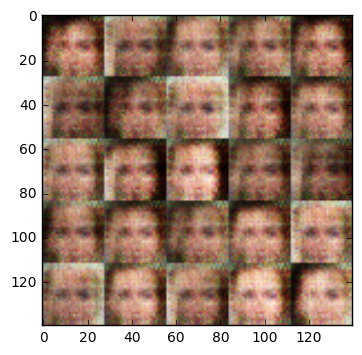

901 Epoch 1/1... Discriminator Loss: 1.7929... Generator Loss: 0.6314
902 Epoch 1/1... Discriminator Loss: 1.6858... Generator Loss: 0.6394
903 Epoch 1/1... Discriminator Loss: 1.5670... Generator Loss: 0.7797
904 Epoch 1/1... Discriminator Loss: 1.8180... Generator Loss: 0.7295
905 Epoch 1/1... Discriminator Loss: 1.6451... Generator Loss: 0.6853
906 Epoch 1/1... Discriminator Loss: 1.4931... Generator Loss: 0.7555
907 Epoch 1/1... Discriminator Loss: 1.4070... Generator Loss: 0.8576
908 Epoch 1/1... Discriminator Loss: 1.4949... Generator Loss: 0.6818
909 Epoch 1/1... Discriminator Loss: 1.4134... Generator Loss: 0.7673
910 Epoch 1/1... Discriminator Loss: 1.4749... Generator Loss: 0.8269
911 Epoch 1/1... Discriminator Loss: 1.4126... Generator Loss: 0.8331
912 Epoch 1/1... Discriminator Loss: 1.4566... Generator Loss: 0.8224
913 Epoch 1/1... Discriminator Loss: 1.4406... Generator Loss: 0.8612
914 Epoch 1/1... Discriminator Loss: 1.3929... Generator Loss: 0.8247
915 Epoch 1/1... Dis

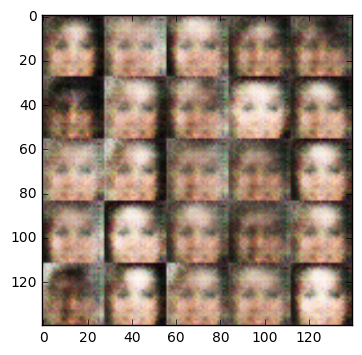

1001 Epoch 1/1... Discriminator Loss: 1.6371... Generator Loss: 0.7370
1002 Epoch 1/1... Discriminator Loss: 1.5628... Generator Loss: 0.7243
1003 Epoch 1/1... Discriminator Loss: 1.4382... Generator Loss: 0.7446
1004 Epoch 1/1... Discriminator Loss: 1.4257... Generator Loss: 0.8038
1005 Epoch 1/1... Discriminator Loss: 1.3854... Generator Loss: 0.7642
1006 Epoch 1/1... Discriminator Loss: 1.4385... Generator Loss: 0.7527
1007 Epoch 1/1... Discriminator Loss: 1.4641... Generator Loss: 0.7168
1008 Epoch 1/1... Discriminator Loss: 1.3870... Generator Loss: 0.7403
1009 Epoch 1/1... Discriminator Loss: 1.4955... Generator Loss: 0.7720
1010 Epoch 1/1... Discriminator Loss: 1.3964... Generator Loss: 0.7884
1011 Epoch 1/1... Discriminator Loss: 1.2971... Generator Loss: 0.8996
1012 Epoch 1/1... Discriminator Loss: 1.2931... Generator Loss: 0.9100
1013 Epoch 1/1... Discriminator Loss: 1.4313... Generator Loss: 0.7613
1014 Epoch 1/1... Discriminator Loss: 1.4059... Generator Loss: 0.8092
1015 E

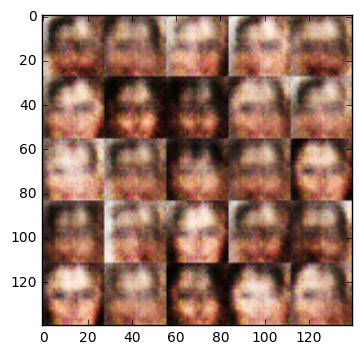

1101 Epoch 1/1... Discriminator Loss: 1.5275... Generator Loss: 0.8138
1102 Epoch 1/1... Discriminator Loss: 1.5059... Generator Loss: 0.7168
1103 Epoch 1/1... Discriminator Loss: 1.4413... Generator Loss: 0.7691
1104 Epoch 1/1... Discriminator Loss: 1.5182... Generator Loss: 0.7793
1105 Epoch 1/1... Discriminator Loss: 1.5796... Generator Loss: 0.8144
1106 Epoch 1/1... Discriminator Loss: 1.5089... Generator Loss: 0.7526
1107 Epoch 1/1... Discriminator Loss: 1.4162... Generator Loss: 0.7271
1108 Epoch 1/1... Discriminator Loss: 1.4284... Generator Loss: 0.8138
1109 Epoch 1/1... Discriminator Loss: 1.4721... Generator Loss: 0.7834
1110 Epoch 1/1... Discriminator Loss: 1.4546... Generator Loss: 0.7551
1111 Epoch 1/1... Discriminator Loss: 1.4020... Generator Loss: 0.8240
1112 Epoch 1/1... Discriminator Loss: 1.4775... Generator Loss: 0.7653
1113 Epoch 1/1... Discriminator Loss: 1.3598... Generator Loss: 0.8005
1114 Epoch 1/1... Discriminator Loss: 1.4313... Generator Loss: 0.7874
1115 E

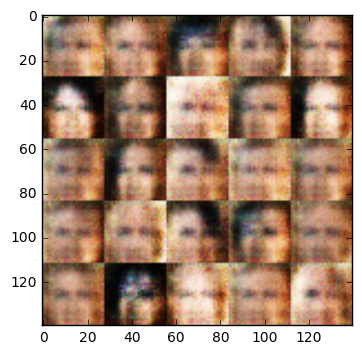

1201 Epoch 1/1... Discriminator Loss: 1.4862... Generator Loss: 0.7745
1202 Epoch 1/1... Discriminator Loss: 1.4893... Generator Loss: 0.6987
1203 Epoch 1/1... Discriminator Loss: 1.4371... Generator Loss: 0.7190
1204 Epoch 1/1... Discriminator Loss: 1.3567... Generator Loss: 0.7876
1205 Epoch 1/1... Discriminator Loss: 1.4680... Generator Loss: 0.8218
1206 Epoch 1/1... Discriminator Loss: 1.4828... Generator Loss: 0.7882
1207 Epoch 1/1... Discriminator Loss: 1.3546... Generator Loss: 0.7751
1208 Epoch 1/1... Discriminator Loss: 1.4719... Generator Loss: 0.7497
1209 Epoch 1/1... Discriminator Loss: 1.3770... Generator Loss: 0.7774
1210 Epoch 1/1... Discriminator Loss: 1.4195... Generator Loss: 0.8102
1211 Epoch 1/1... Discriminator Loss: 1.3623... Generator Loss: 0.8465
1212 Epoch 1/1... Discriminator Loss: 1.4054... Generator Loss: 0.7706
1213 Epoch 1/1... Discriminator Loss: 1.3897... Generator Loss: 0.7619
1214 Epoch 1/1... Discriminator Loss: 1.4058... Generator Loss: 0.7871
1215 E

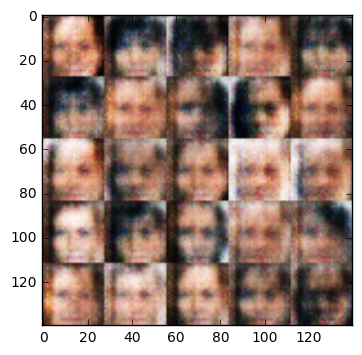

1301 Epoch 1/1... Discriminator Loss: 1.4071... Generator Loss: 0.7448
1302 Epoch 1/1... Discriminator Loss: 1.3399... Generator Loss: 0.7691
1303 Epoch 1/1... Discriminator Loss: 1.3967... Generator Loss: 0.7515
1304 Epoch 1/1... Discriminator Loss: 1.3042... Generator Loss: 0.8613
1305 Epoch 1/1... Discriminator Loss: 1.3976... Generator Loss: 0.8030
1306 Epoch 1/1... Discriminator Loss: 1.4185... Generator Loss: 0.7888
1307 Epoch 1/1... Discriminator Loss: 1.4386... Generator Loss: 0.7585
1308 Epoch 1/1... Discriminator Loss: 1.4992... Generator Loss: 0.7420
1309 Epoch 1/1... Discriminator Loss: 1.4340... Generator Loss: 0.7892
1310 Epoch 1/1... Discriminator Loss: 1.4052... Generator Loss: 0.8068
1311 Epoch 1/1... Discriminator Loss: 1.3603... Generator Loss: 0.9011
1312 Epoch 1/1... Discriminator Loss: 1.3670... Generator Loss: 0.8223
1313 Epoch 1/1... Discriminator Loss: 1.4344... Generator Loss: 0.7118
1314 Epoch 1/1... Discriminator Loss: 1.4276... Generator Loss: 0.7254
1315 E

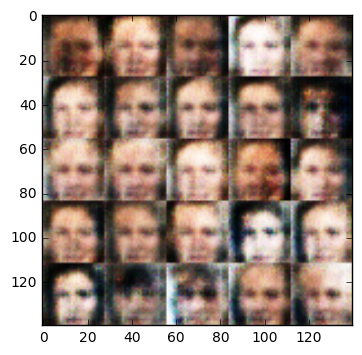

1401 Epoch 1/1... Discriminator Loss: 1.3181... Generator Loss: 0.8537
1402 Epoch 1/1... Discriminator Loss: 1.3676... Generator Loss: 0.7701
1403 Epoch 1/1... Discriminator Loss: 1.4622... Generator Loss: 0.7110
1404 Epoch 1/1... Discriminator Loss: 1.3881... Generator Loss: 0.7929
1405 Epoch 1/1... Discriminator Loss: 1.3870... Generator Loss: 0.8131
1406 Epoch 1/1... Discriminator Loss: 1.4858... Generator Loss: 0.7507
1407 Epoch 1/1... Discriminator Loss: 1.4043... Generator Loss: 0.8150
1408 Epoch 1/1... Discriminator Loss: 1.4511... Generator Loss: 0.7285
1409 Epoch 1/1... Discriminator Loss: 1.4851... Generator Loss: 0.7278
1410 Epoch 1/1... Discriminator Loss: 1.5053... Generator Loss: 0.7314
1411 Epoch 1/1... Discriminator Loss: 1.4305... Generator Loss: 0.7691
1412 Epoch 1/1... Discriminator Loss: 1.5135... Generator Loss: 0.7342
1413 Epoch 1/1... Discriminator Loss: 1.4353... Generator Loss: 0.7539
1414 Epoch 1/1... Discriminator Loss: 1.4363... Generator Loss: 0.7786
1415 E

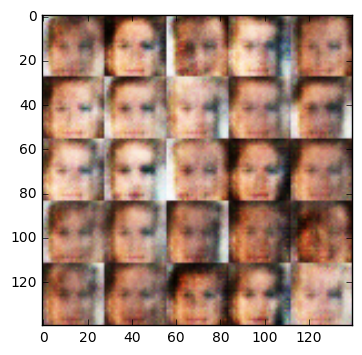

1501 Epoch 1/1... Discriminator Loss: 1.4293... Generator Loss: 0.7810
1502 Epoch 1/1... Discriminator Loss: 1.5098... Generator Loss: 0.6950
1503 Epoch 1/1... Discriminator Loss: 1.5197... Generator Loss: 0.6826
1504 Epoch 1/1... Discriminator Loss: 1.4399... Generator Loss: 0.7131
1505 Epoch 1/1... Discriminator Loss: 1.3937... Generator Loss: 0.7487
1506 Epoch 1/1... Discriminator Loss: 1.3783... Generator Loss: 0.8044
1507 Epoch 1/1... Discriminator Loss: 1.5094... Generator Loss: 0.7901
1508 Epoch 1/1... Discriminator Loss: 1.4324... Generator Loss: 0.8393
1509 Epoch 1/1... Discriminator Loss: 1.4938... Generator Loss: 0.7063
1510 Epoch 1/1... Discriminator Loss: 1.3837... Generator Loss: 0.7430
1511 Epoch 1/1... Discriminator Loss: 1.3790... Generator Loss: 0.8235
1512 Epoch 1/1... Discriminator Loss: 1.3567... Generator Loss: 0.8565
1513 Epoch 1/1... Discriminator Loss: 1.4052... Generator Loss: 0.8224
1514 Epoch 1/1... Discriminator Loss: 1.4686... Generator Loss: 0.7272
1515 E

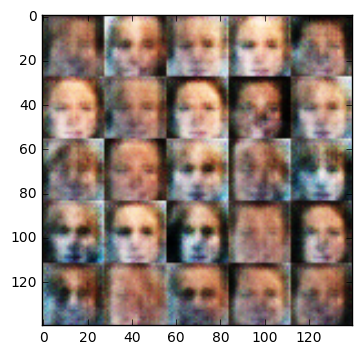

1601 Epoch 1/1... Discriminator Loss: 1.3814... Generator Loss: 0.7975
1602 Epoch 1/1... Discriminator Loss: 1.4055... Generator Loss: 0.8105
1603 Epoch 1/1... Discriminator Loss: 1.4140... Generator Loss: 0.7749
1604 Epoch 1/1... Discriminator Loss: 1.4081... Generator Loss: 0.7283
1605 Epoch 1/1... Discriminator Loss: 1.5150... Generator Loss: 0.6500
1606 Epoch 1/1... Discriminator Loss: 1.5060... Generator Loss: 0.7587
1607 Epoch 1/1... Discriminator Loss: 1.4170... Generator Loss: 0.8693
1608 Epoch 1/1... Discriminator Loss: 1.4495... Generator Loss: 0.8164
1609 Epoch 1/1... Discriminator Loss: 1.4874... Generator Loss: 0.6902
1610 Epoch 1/1... Discriminator Loss: 1.4054... Generator Loss: 0.7685
1611 Epoch 1/1... Discriminator Loss: 1.5043... Generator Loss: 0.7043
1612 Epoch 1/1... Discriminator Loss: 1.4440... Generator Loss: 0.7698
1613 Epoch 1/1... Discriminator Loss: 1.4055... Generator Loss: 0.8156
1614 Epoch 1/1... Discriminator Loss: 1.4466... Generator Loss: 0.7376
1615 E

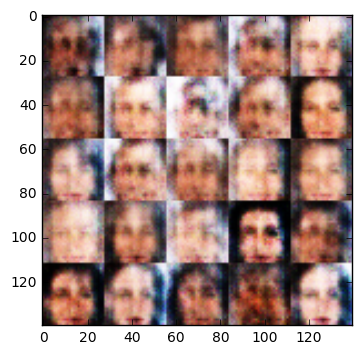

1701 Epoch 1/1... Discriminator Loss: 1.4453... Generator Loss: 0.7069
1702 Epoch 1/1... Discriminator Loss: 1.3618... Generator Loss: 0.8380
1703 Epoch 1/1... Discriminator Loss: 1.4360... Generator Loss: 0.7953
1704 Epoch 1/1... Discriminator Loss: 1.4585... Generator Loss: 0.7592
1705 Epoch 1/1... Discriminator Loss: 1.4066... Generator Loss: 0.7287
1706 Epoch 1/1... Discriminator Loss: 1.3857... Generator Loss: 0.7779
1707 Epoch 1/1... Discriminator Loss: 1.4489... Generator Loss: 0.7277
1708 Epoch 1/1... Discriminator Loss: 1.4792... Generator Loss: 0.7678
1709 Epoch 1/1... Discriminator Loss: 1.4854... Generator Loss: 0.8023
1710 Epoch 1/1... Discriminator Loss: 1.4225... Generator Loss: 0.7684
1711 Epoch 1/1... Discriminator Loss: 1.4998... Generator Loss: 0.6867
1712 Epoch 1/1... Discriminator Loss: 1.4133... Generator Loss: 0.7621
1713 Epoch 1/1... Discriminator Loss: 1.4040... Generator Loss: 0.8456
1714 Epoch 1/1... Discriminator Loss: 1.3973... Generator Loss: 0.8097
1715 E

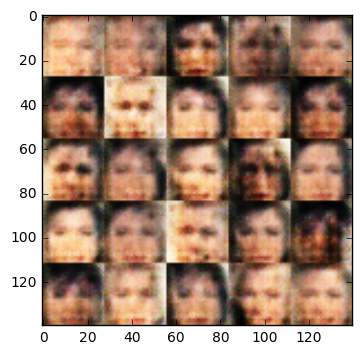

1801 Epoch 1/1... Discriminator Loss: 1.3617... Generator Loss: 0.8186
1802 Epoch 1/1... Discriminator Loss: 1.4796... Generator Loss: 0.7329
1803 Epoch 1/1... Discriminator Loss: 1.3535... Generator Loss: 0.7790
1804 Epoch 1/1... Discriminator Loss: 1.3274... Generator Loss: 0.7620
1805 Epoch 1/1... Discriminator Loss: 1.4721... Generator Loss: 0.7590
1806 Epoch 1/1... Discriminator Loss: 1.4369... Generator Loss: 0.7899
1807 Epoch 1/1... Discriminator Loss: 1.4095... Generator Loss: 0.7995
1808 Epoch 1/1... Discriminator Loss: 1.4858... Generator Loss: 0.6748
1809 Epoch 1/1... Discriminator Loss: 1.4272... Generator Loss: 0.7168
1810 Epoch 1/1... Discriminator Loss: 1.4497... Generator Loss: 0.7449
1811 Epoch 1/1... Discriminator Loss: 1.4653... Generator Loss: 0.7030
1812 Epoch 1/1... Discriminator Loss: 1.3928... Generator Loss: 0.7221
1813 Epoch 1/1... Discriminator Loss: 1.4537... Generator Loss: 0.7026
1814 Epoch 1/1... Discriminator Loss: 1.4289... Generator Loss: 0.7443
1815 E

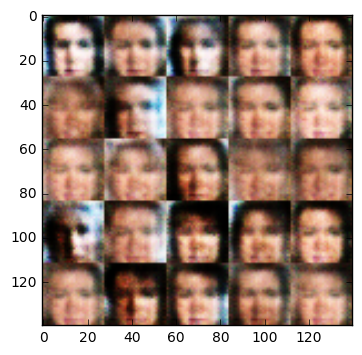

1901 Epoch 1/1... Discriminator Loss: 1.4019... Generator Loss: 0.8616
1902 Epoch 1/1... Discriminator Loss: 1.3935... Generator Loss: 0.8439
1903 Epoch 1/1... Discriminator Loss: 1.3892... Generator Loss: 0.7739
1904 Epoch 1/1... Discriminator Loss: 1.3270... Generator Loss: 0.6978
1905 Epoch 1/1... Discriminator Loss: 1.4339... Generator Loss: 0.7243
1906 Epoch 1/1... Discriminator Loss: 1.3924... Generator Loss: 0.8233
1907 Epoch 1/1... Discriminator Loss: 1.3863... Generator Loss: 0.8480
1908 Epoch 1/1... Discriminator Loss: 1.4098... Generator Loss: 0.7861
1909 Epoch 1/1... Discriminator Loss: 1.4147... Generator Loss: 0.7376
1910 Epoch 1/1... Discriminator Loss: 1.4480... Generator Loss: 0.7472
1911 Epoch 1/1... Discriminator Loss: 1.5285... Generator Loss: 0.7679
1912 Epoch 1/1... Discriminator Loss: 1.4581... Generator Loss: 0.8142
1913 Epoch 1/1... Discriminator Loss: 1.4181... Generator Loss: 0.7991
1914 Epoch 1/1... Discriminator Loss: 1.4504... Generator Loss: 0.7862
1915 E

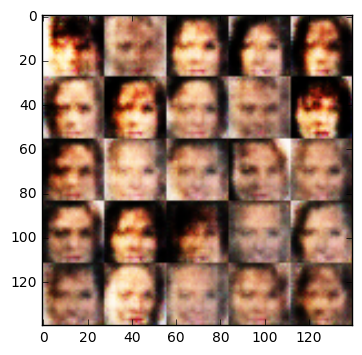

2001 Epoch 1/1... Discriminator Loss: 1.3911... Generator Loss: 0.7948
2002 Epoch 1/1... Discriminator Loss: 1.4343... Generator Loss: 0.7604
2003 Epoch 1/1... Discriminator Loss: 1.4582... Generator Loss: 0.7550
2004 Epoch 1/1... Discriminator Loss: 1.4464... Generator Loss: 0.7304
2005 Epoch 1/1... Discriminator Loss: 1.4441... Generator Loss: 0.7348
2006 Epoch 1/1... Discriminator Loss: 1.4834... Generator Loss: 0.7153
2007 Epoch 1/1... Discriminator Loss: 1.4830... Generator Loss: 0.7321
2008 Epoch 1/1... Discriminator Loss: 1.4585... Generator Loss: 0.7073
2009 Epoch 1/1... Discriminator Loss: 1.4736... Generator Loss: 0.7381
2010 Epoch 1/1... Discriminator Loss: 1.4897... Generator Loss: 0.7911
2011 Epoch 1/1... Discriminator Loss: 1.4619... Generator Loss: 0.7741
2012 Epoch 1/1... Discriminator Loss: 1.3996... Generator Loss: 0.7922
2013 Epoch 1/1... Discriminator Loss: 1.4208... Generator Loss: 0.7443
2014 Epoch 1/1... Discriminator Loss: 1.3898... Generator Loss: 0.7342
2015 E

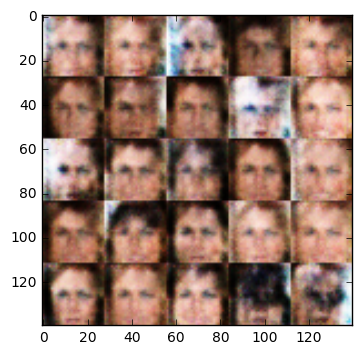

2101 Epoch 1/1... Discriminator Loss: 1.4618... Generator Loss: 0.7704
2102 Epoch 1/1... Discriminator Loss: 1.4068... Generator Loss: 0.8061
2103 Epoch 1/1... Discriminator Loss: 1.4063... Generator Loss: 0.7845
2104 Epoch 1/1... Discriminator Loss: 1.4587... Generator Loss: 0.7428
2105 Epoch 1/1... Discriminator Loss: 1.4580... Generator Loss: 0.7357
2106 Epoch 1/1... Discriminator Loss: 1.4294... Generator Loss: 0.7305
2107 Epoch 1/1... Discriminator Loss: 1.3674... Generator Loss: 0.7482
2108 Epoch 1/1... Discriminator Loss: 1.4118... Generator Loss: 0.7347
2109 Epoch 1/1... Discriminator Loss: 1.4381... Generator Loss: 0.7189
2110 Epoch 1/1... Discriminator Loss: 1.4416... Generator Loss: 0.7554
2111 Epoch 1/1... Discriminator Loss: 1.3961... Generator Loss: 0.8656
2112 Epoch 1/1... Discriminator Loss: 1.4177... Generator Loss: 0.8138
2113 Epoch 1/1... Discriminator Loss: 1.4058... Generator Loss: 0.7510
2114 Epoch 1/1... Discriminator Loss: 1.4062... Generator Loss: 0.7273
2115 E

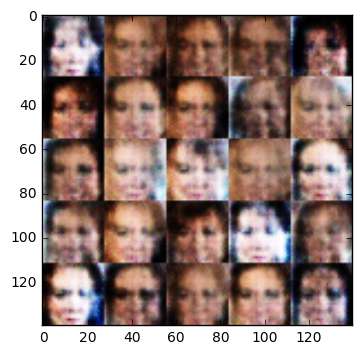

2201 Epoch 1/1... Discriminator Loss: 1.4253... Generator Loss: 0.7053
2202 Epoch 1/1... Discriminator Loss: 1.4425... Generator Loss: 0.7396
2203 Epoch 1/1... Discriminator Loss: 1.4368... Generator Loss: 0.7318
2204 Epoch 1/1... Discriminator Loss: 1.3917... Generator Loss: 0.7368
2205 Epoch 1/1... Discriminator Loss: 1.4499... Generator Loss: 0.7625
2206 Epoch 1/1... Discriminator Loss: 1.4423... Generator Loss: 0.8074
2207 Epoch 1/1... Discriminator Loss: 1.4795... Generator Loss: 0.7381
2208 Epoch 1/1... Discriminator Loss: 1.4485... Generator Loss: 0.6827
2209 Epoch 1/1... Discriminator Loss: 1.4568... Generator Loss: 0.7306
2210 Epoch 1/1... Discriminator Loss: 1.4442... Generator Loss: 0.7434
2211 Epoch 1/1... Discriminator Loss: 1.3663... Generator Loss: 0.7502
2212 Epoch 1/1... Discriminator Loss: 1.4679... Generator Loss: 0.7309
2213 Epoch 1/1... Discriminator Loss: 1.4279... Generator Loss: 0.7634
2214 Epoch 1/1... Discriminator Loss: 1.4084... Generator Loss: 0.7710
2215 E

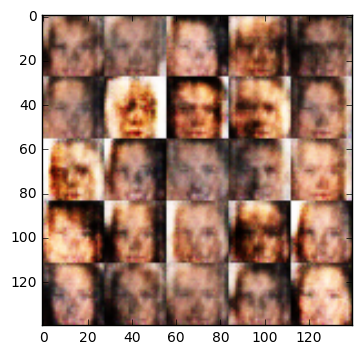

2301 Epoch 1/1... Discriminator Loss: 1.3631... Generator Loss: 0.8251
2302 Epoch 1/1... Discriminator Loss: 1.4026... Generator Loss: 0.7869
2303 Epoch 1/1... Discriminator Loss: 1.3688... Generator Loss: 0.7601
2304 Epoch 1/1... Discriminator Loss: 1.3931... Generator Loss: 0.7930
2305 Epoch 1/1... Discriminator Loss: 1.4084... Generator Loss: 0.8087
2306 Epoch 1/1... Discriminator Loss: 1.4042... Generator Loss: 0.7874
2307 Epoch 1/1... Discriminator Loss: 1.4163... Generator Loss: 0.7752
2308 Epoch 1/1... Discriminator Loss: 1.4325... Generator Loss: 0.7907
2309 Epoch 1/1... Discriminator Loss: 1.4316... Generator Loss: 0.7901
2310 Epoch 1/1... Discriminator Loss: 1.4120... Generator Loss: 0.8237
2311 Epoch 1/1... Discriminator Loss: 1.3772... Generator Loss: 0.7879
2312 Epoch 1/1... Discriminator Loss: 1.4521... Generator Loss: 0.7617
2313 Epoch 1/1... Discriminator Loss: 1.3526... Generator Loss: 0.7971
2314 Epoch 1/1... Discriminator Loss: 1.4256... Generator Loss: 0.8112
2315 E

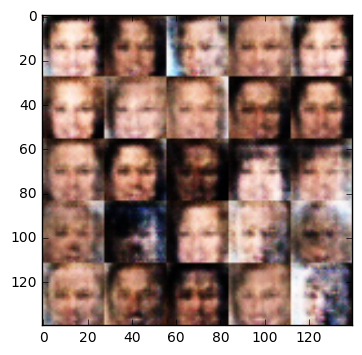

2401 Epoch 1/1... Discriminator Loss: 1.4536... Generator Loss: 0.7099
2402 Epoch 1/1... Discriminator Loss: 1.4914... Generator Loss: 0.6882
2403 Epoch 1/1... Discriminator Loss: 1.4442... Generator Loss: 0.7467
2404 Epoch 1/1... Discriminator Loss: 1.4155... Generator Loss: 0.7674
2405 Epoch 1/1... Discriminator Loss: 1.4632... Generator Loss: 0.7634
2406 Epoch 1/1... Discriminator Loss: 1.4370... Generator Loss: 0.8309
2407 Epoch 1/1... Discriminator Loss: 1.4800... Generator Loss: 0.7830
2408 Epoch 1/1... Discriminator Loss: 1.4481... Generator Loss: 0.8108
2409 Epoch 1/1... Discriminator Loss: 1.4461... Generator Loss: 0.7819
2410 Epoch 1/1... Discriminator Loss: 1.4427... Generator Loss: 0.7742
2411 Epoch 1/1... Discriminator Loss: 1.4599... Generator Loss: 0.7247
2412 Epoch 1/1... Discriminator Loss: 1.5012... Generator Loss: 0.7367
2413 Epoch 1/1... Discriminator Loss: 1.4495... Generator Loss: 0.7680
2414 Epoch 1/1... Discriminator Loss: 1.4147... Generator Loss: 0.7449
2415 E

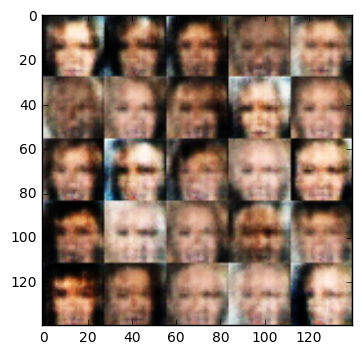

2501 Epoch 1/1... Discriminator Loss: 1.4045... Generator Loss: 0.7658
2502 Epoch 1/1... Discriminator Loss: 1.4521... Generator Loss: 0.7445
2503 Epoch 1/1... Discriminator Loss: 1.4661... Generator Loss: 0.7102
2504 Epoch 1/1... Discriminator Loss: 1.4615... Generator Loss: 0.7038
2505 Epoch 1/1... Discriminator Loss: 1.5230... Generator Loss: 0.6833
2506 Epoch 1/1... Discriminator Loss: 1.3993... Generator Loss: 0.7837
2507 Epoch 1/1... Discriminator Loss: 1.4509... Generator Loss: 0.8307
2508 Epoch 1/1... Discriminator Loss: 1.3716... Generator Loss: 0.8314
2509 Epoch 1/1... Discriminator Loss: 1.3190... Generator Loss: 0.8172
2510 Epoch 1/1... Discriminator Loss: 1.3723... Generator Loss: 0.8039
2511 Epoch 1/1... Discriminator Loss: 1.3515... Generator Loss: 0.8040
2512 Epoch 1/1... Discriminator Loss: 1.3810... Generator Loss: 0.7703
2513 Epoch 1/1... Discriminator Loss: 1.4317... Generator Loss: 0.7754
2514 Epoch 1/1... Discriminator Loss: 1.4601... Generator Loss: 0.7501
2515 E

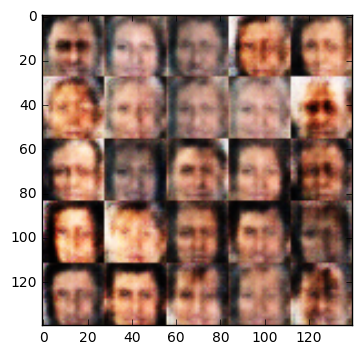

2601 Epoch 1/1... Discriminator Loss: 1.4048... Generator Loss: 0.7814
2602 Epoch 1/1... Discriminator Loss: 1.4090... Generator Loss: 0.7562
2603 Epoch 1/1... Discriminator Loss: 1.3884... Generator Loss: 0.8258
2604 Epoch 1/1... Discriminator Loss: 1.3891... Generator Loss: 0.8111
2605 Epoch 1/1... Discriminator Loss: 1.4403... Generator Loss: 0.7573
2606 Epoch 1/1... Discriminator Loss: 1.4095... Generator Loss: 0.7684
2607 Epoch 1/1... Discriminator Loss: 1.4270... Generator Loss: 0.7628
2608 Epoch 1/1... Discriminator Loss: 1.4909... Generator Loss: 0.7554
2609 Epoch 1/1... Discriminator Loss: 1.4509... Generator Loss: 0.7432
2610 Epoch 1/1... Discriminator Loss: 1.3986... Generator Loss: 0.7532
2611 Epoch 1/1... Discriminator Loss: 1.4132... Generator Loss: 0.7487
2612 Epoch 1/1... Discriminator Loss: 1.4314... Generator Loss: 0.7675
2613 Epoch 1/1... Discriminator Loss: 1.3829... Generator Loss: 0.8035
2614 Epoch 1/1... Discriminator Loss: 1.4153... Generator Loss: 0.7962
2615 E

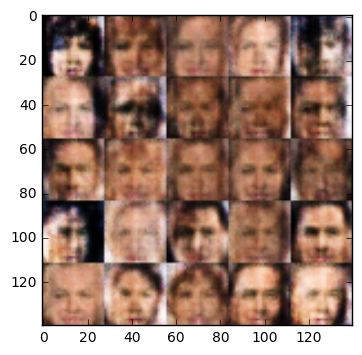

2701 Epoch 1/1... Discriminator Loss: 1.4208... Generator Loss: 0.7035
2702 Epoch 1/1... Discriminator Loss: 1.4514... Generator Loss: 0.7112
2703 Epoch 1/1... Discriminator Loss: 1.3768... Generator Loss: 0.7993
2704 Epoch 1/1... Discriminator Loss: 1.4143... Generator Loss: 0.8588
2705 Epoch 1/1... Discriminator Loss: 1.4348... Generator Loss: 0.8129
2706 Epoch 1/1... Discriminator Loss: 1.4307... Generator Loss: 0.7739
2707 Epoch 1/1... Discriminator Loss: 1.4065... Generator Loss: 0.7187
2708 Epoch 1/1... Discriminator Loss: 1.4080... Generator Loss: 0.7612
2709 Epoch 1/1... Discriminator Loss: 1.4142... Generator Loss: 0.7795
2710 Epoch 1/1... Discriminator Loss: 1.3344... Generator Loss: 0.8369
2711 Epoch 1/1... Discriminator Loss: 1.3721... Generator Loss: 0.8014
2712 Epoch 1/1... Discriminator Loss: 1.4230... Generator Loss: 0.7387
2713 Epoch 1/1... Discriminator Loss: 1.4553... Generator Loss: 0.7293
2714 Epoch 1/1... Discriminator Loss: 1.4226... Generator Loss: 0.7464
2715 E

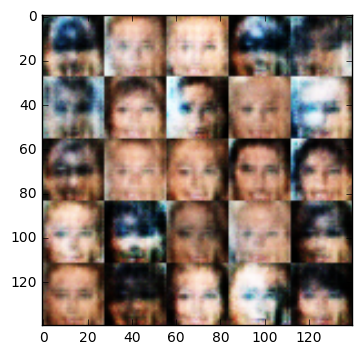

2801 Epoch 1/1... Discriminator Loss: 1.4670... Generator Loss: 0.7200
2802 Epoch 1/1... Discriminator Loss: 1.4820... Generator Loss: 0.7025
2803 Epoch 1/1... Discriminator Loss: 1.4341... Generator Loss: 0.7378
2804 Epoch 1/1... Discriminator Loss: 1.4590... Generator Loss: 0.8044
2805 Epoch 1/1... Discriminator Loss: 1.4706... Generator Loss: 0.7507
2806 Epoch 1/1... Discriminator Loss: 1.4277... Generator Loss: 0.7588
2807 Epoch 1/1... Discriminator Loss: 1.4535... Generator Loss: 0.7230
2808 Epoch 1/1... Discriminator Loss: 1.4590... Generator Loss: 0.7738
2809 Epoch 1/1... Discriminator Loss: 1.4307... Generator Loss: 0.8217
2810 Epoch 1/1... Discriminator Loss: 1.3911... Generator Loss: 0.8186
2811 Epoch 1/1... Discriminator Loss: 1.4045... Generator Loss: 0.8036
2812 Epoch 1/1... Discriminator Loss: 1.4527... Generator Loss: 0.7205
2813 Epoch 1/1... Discriminator Loss: 1.4584... Generator Loss: 0.7275
2814 Epoch 1/1... Discriminator Loss: 1.4214... Generator Loss: 0.7606
2815 E

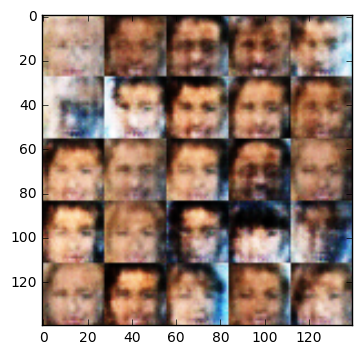

2901 Epoch 1/1... Discriminator Loss: 1.4184... Generator Loss: 0.8043
2902 Epoch 1/1... Discriminator Loss: 1.3612... Generator Loss: 0.8641
2903 Epoch 1/1... Discriminator Loss: 1.3644... Generator Loss: 0.8006
2904 Epoch 1/1... Discriminator Loss: 1.4120... Generator Loss: 0.7570
2905 Epoch 1/1... Discriminator Loss: 1.4451... Generator Loss: 0.7489
2906 Epoch 1/1... Discriminator Loss: 1.4623... Generator Loss: 0.7597
2907 Epoch 1/1... Discriminator Loss: 1.4848... Generator Loss: 0.7462
2908 Epoch 1/1... Discriminator Loss: 1.4569... Generator Loss: 0.7340
2909 Epoch 1/1... Discriminator Loss: 1.4814... Generator Loss: 0.7102
2910 Epoch 1/1... Discriminator Loss: 1.4326... Generator Loss: 0.7577
2911 Epoch 1/1... Discriminator Loss: 1.4544... Generator Loss: 0.7721
2912 Epoch 1/1... Discriminator Loss: 1.4077... Generator Loss: 0.7747
2913 Epoch 1/1... Discriminator Loss: 1.3724... Generator Loss: 0.7725
2914 Epoch 1/1... Discriminator Loss: 1.3492... Generator Loss: 0.7724
2915 E

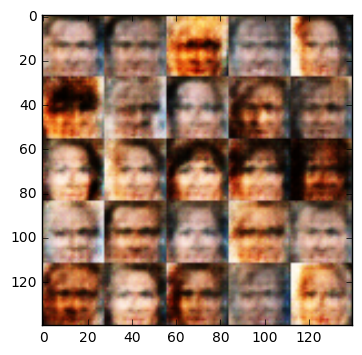

3001 Epoch 1/1... Discriminator Loss: 1.4003... Generator Loss: 0.8005
3002 Epoch 1/1... Discriminator Loss: 1.3897... Generator Loss: 0.8295
3003 Epoch 1/1... Discriminator Loss: 1.3784... Generator Loss: 0.8285
3004 Epoch 1/1... Discriminator Loss: 1.4005... Generator Loss: 0.7397
3005 Epoch 1/1... Discriminator Loss: 1.4532... Generator Loss: 0.7581
3006 Epoch 1/1... Discriminator Loss: 1.4396... Generator Loss: 0.7797
3007 Epoch 1/1... Discriminator Loss: 1.4036... Generator Loss: 0.8689
3008 Epoch 1/1... Discriminator Loss: 1.4023... Generator Loss: 0.8601
3009 Epoch 1/1... Discriminator Loss: 1.3818... Generator Loss: 0.8720
3010 Epoch 1/1... Discriminator Loss: 1.4494... Generator Loss: 0.7849
3011 Epoch 1/1... Discriminator Loss: 1.4332... Generator Loss: 0.7289
3012 Epoch 1/1... Discriminator Loss: 1.4642... Generator Loss: 0.7362
3013 Epoch 1/1... Discriminator Loss: 1.4206... Generator Loss: 0.7342
3014 Epoch 1/1... Discriminator Loss: 1.4176... Generator Loss: 0.7635
3015 E

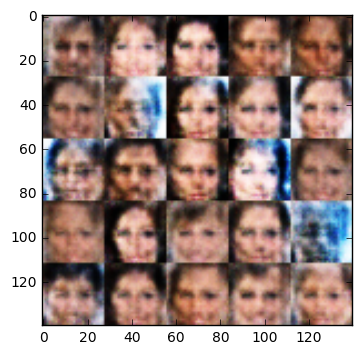

3101 Epoch 1/1... Discriminator Loss: 1.4191... Generator Loss: 0.7762
3102 Epoch 1/1... Discriminator Loss: 1.4041... Generator Loss: 0.7805
3103 Epoch 1/1... Discriminator Loss: 1.4104... Generator Loss: 0.7909
3104 Epoch 1/1... Discriminator Loss: 1.4082... Generator Loss: 0.8020
3105 Epoch 1/1... Discriminator Loss: 1.4082... Generator Loss: 0.7833
3106 Epoch 1/1... Discriminator Loss: 1.3667... Generator Loss: 0.7951
3107 Epoch 1/1... Discriminator Loss: 1.3867... Generator Loss: 0.7814
3108 Epoch 1/1... Discriminator Loss: 1.3701... Generator Loss: 0.7475
3109 Epoch 1/1... Discriminator Loss: 1.3861... Generator Loss: 0.7453
3110 Epoch 1/1... Discriminator Loss: 1.4284... Generator Loss: 0.7561
3111 Epoch 1/1... Discriminator Loss: 1.4069... Generator Loss: 0.7939
3112 Epoch 1/1... Discriminator Loss: 1.4204... Generator Loss: 0.8017
3113 Epoch 1/1... Discriminator Loss: 1.5023... Generator Loss: 0.7508
3114 Epoch 1/1... Discriminator Loss: 1.4073... Generator Loss: 0.7803
3115 E

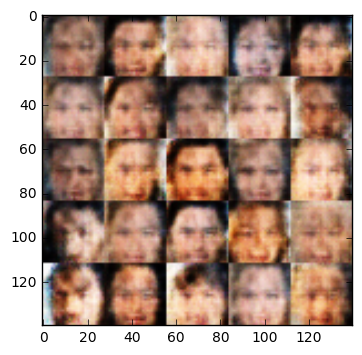

3201 Epoch 1/1... Discriminator Loss: 1.4431... Generator Loss: 0.7811
3202 Epoch 1/1... Discriminator Loss: 1.4558... Generator Loss: 0.7370
3203 Epoch 1/1... Discriminator Loss: 1.4672... Generator Loss: 0.7654
3204 Epoch 1/1... Discriminator Loss: 1.4394... Generator Loss: 0.7756
3205 Epoch 1/1... Discriminator Loss: 1.4431... Generator Loss: 0.7575
3206 Epoch 1/1... Discriminator Loss: 1.4576... Generator Loss: 0.7544
3207 Epoch 1/1... Discriminator Loss: 1.4005... Generator Loss: 0.7878
3208 Epoch 1/1... Discriminator Loss: 1.3466... Generator Loss: 0.8000
3209 Epoch 1/1... Discriminator Loss: 1.3486... Generator Loss: 0.7576
3210 Epoch 1/1... Discriminator Loss: 1.3569... Generator Loss: 0.7877
3211 Epoch 1/1... Discriminator Loss: 1.4088... Generator Loss: 0.7643
3212 Epoch 1/1... Discriminator Loss: 1.4184... Generator Loss: 0.7715
3213 Epoch 1/1... Discriminator Loss: 1.4609... Generator Loss: 0.7555
3214 Epoch 1/1... Discriminator Loss: 1.4202... Generator Loss: 0.7692
3215 E

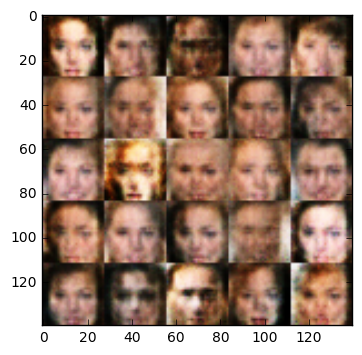

3301 Epoch 1/1... Discriminator Loss: 1.3979... Generator Loss: 0.8058
3302 Epoch 1/1... Discriminator Loss: 1.3616... Generator Loss: 0.8508
3303 Epoch 1/1... Discriminator Loss: 1.4209... Generator Loss: 0.7939
3304 Epoch 1/1... Discriminator Loss: 1.4325... Generator Loss: 0.7465
3305 Epoch 1/1... Discriminator Loss: 1.4257... Generator Loss: 0.7079
3306 Epoch 1/1... Discriminator Loss: 1.3982... Generator Loss: 0.7262
3307 Epoch 1/1... Discriminator Loss: 1.4342... Generator Loss: 0.7672
3308 Epoch 1/1... Discriminator Loss: 1.3984... Generator Loss: 0.8184
3309 Epoch 1/1... Discriminator Loss: 1.3994... Generator Loss: 0.7892
3310 Epoch 1/1... Discriminator Loss: 1.3897... Generator Loss: 0.7711
3311 Epoch 1/1... Discriminator Loss: 1.4516... Generator Loss: 0.7149
3312 Epoch 1/1... Discriminator Loss: 1.4119... Generator Loss: 0.7229
3313 Epoch 1/1... Discriminator Loss: 1.4467... Generator Loss: 0.7184
3314 Epoch 1/1... Discriminator Loss: 1.4453... Generator Loss: 0.7286
3315 E

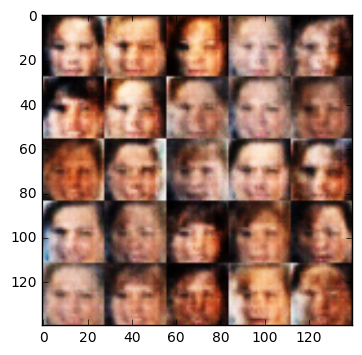

3401 Epoch 1/1... Discriminator Loss: 1.3840... Generator Loss: 0.8010
3402 Epoch 1/1... Discriminator Loss: 1.4104... Generator Loss: 0.7954
3403 Epoch 1/1... Discriminator Loss: 1.4041... Generator Loss: 0.7897
3404 Epoch 1/1... Discriminator Loss: 1.3753... Generator Loss: 0.8137
3405 Epoch 1/1... Discriminator Loss: 1.3782... Generator Loss: 0.8249
3406 Epoch 1/1... Discriminator Loss: 1.4077... Generator Loss: 0.8373
3407 Epoch 1/1... Discriminator Loss: 1.4061... Generator Loss: 0.7779
3408 Epoch 1/1... Discriminator Loss: 1.5181... Generator Loss: 0.6960
3409 Epoch 1/1... Discriminator Loss: 1.4927... Generator Loss: 0.6943
3410 Epoch 1/1... Discriminator Loss: 1.4371... Generator Loss: 0.7617
3411 Epoch 1/1... Discriminator Loss: 1.4334... Generator Loss: 0.7905
3412 Epoch 1/1... Discriminator Loss: 1.4067... Generator Loss: 0.7396
3413 Epoch 1/1... Discriminator Loss: 1.4143... Generator Loss: 0.6945
3414 Epoch 1/1... Discriminator Loss: 1.3779... Generator Loss: 0.7097
3415 E

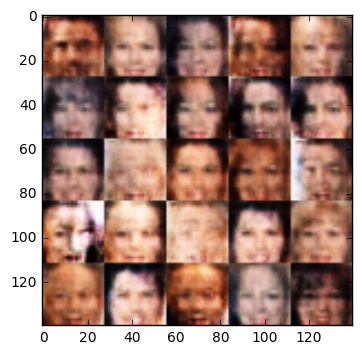

3501 Epoch 1/1... Discriminator Loss: 1.3952... Generator Loss: 0.7406
3502 Epoch 1/1... Discriminator Loss: 1.4550... Generator Loss: 0.7232
3503 Epoch 1/1... Discriminator Loss: 1.3976... Generator Loss: 0.7712
3504 Epoch 1/1... Discriminator Loss: 1.4312... Generator Loss: 0.8000
3505 Epoch 1/1... Discriminator Loss: 1.3856... Generator Loss: 0.8111
3506 Epoch 1/1... Discriminator Loss: 1.3931... Generator Loss: 0.8351
3507 Epoch 1/1... Discriminator Loss: 1.3834... Generator Loss: 0.7842
3508 Epoch 1/1... Discriminator Loss: 1.4097... Generator Loss: 0.7467
3509 Epoch 1/1... Discriminator Loss: 1.4001... Generator Loss: 0.7550
3510 Epoch 1/1... Discriminator Loss: 1.4092... Generator Loss: 0.8179
3511 Epoch 1/1... Discriminator Loss: 1.4099... Generator Loss: 0.8195
3512 Epoch 1/1... Discriminator Loss: 1.4024... Generator Loss: 0.8139
3513 Epoch 1/1... Discriminator Loss: 1.4078... Generator Loss: 0.7546
3514 Epoch 1/1... Discriminator Loss: 1.4403... Generator Loss: 0.7249
3515 E

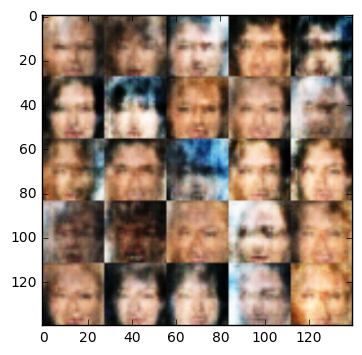

3601 Epoch 1/1... Discriminator Loss: 1.3900... Generator Loss: 0.7883
3602 Epoch 1/1... Discriminator Loss: 1.3748... Generator Loss: 0.8152
3603 Epoch 1/1... Discriminator Loss: 1.3927... Generator Loss: 0.7807
3604 Epoch 1/1... Discriminator Loss: 1.3842... Generator Loss: 0.7844
3605 Epoch 1/1... Discriminator Loss: 1.4107... Generator Loss: 0.7773
3606 Epoch 1/1... Discriminator Loss: 1.4735... Generator Loss: 0.7392
3607 Epoch 1/1... Discriminator Loss: 1.4258... Generator Loss: 0.7365
3608 Epoch 1/1... Discriminator Loss: 1.4215... Generator Loss: 0.7444
3609 Epoch 1/1... Discriminator Loss: 1.4602... Generator Loss: 0.7832
3610 Epoch 1/1... Discriminator Loss: 1.4447... Generator Loss: 0.7656
3611 Epoch 1/1... Discriminator Loss: 1.4226... Generator Loss: 0.8050
3612 Epoch 1/1... Discriminator Loss: 1.3909... Generator Loss: 0.8052
3613 Epoch 1/1... Discriminator Loss: 1.4099... Generator Loss: 0.7799
3614 Epoch 1/1... Discriminator Loss: 1.4015... Generator Loss: 0.8234
3615 E

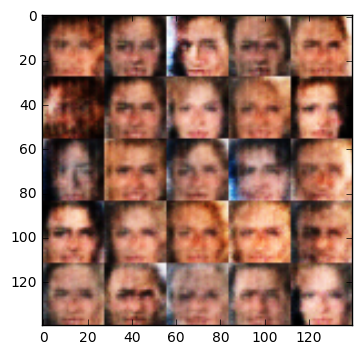

3701 Epoch 1/1... Discriminator Loss: 1.4358... Generator Loss: 0.7527
3702 Epoch 1/1... Discriminator Loss: 1.3772... Generator Loss: 0.8125
3703 Epoch 1/1... Discriminator Loss: 1.4345... Generator Loss: 0.7638
3704 Epoch 1/1... Discriminator Loss: 1.4011... Generator Loss: 0.7987
3705 Epoch 1/1... Discriminator Loss: 1.3984... Generator Loss: 0.8010
3706 Epoch 1/1... Discriminator Loss: 1.4051... Generator Loss: 0.7834
3707 Epoch 1/1... Discriminator Loss: 1.4180... Generator Loss: 0.7435
3708 Epoch 1/1... Discriminator Loss: 1.3884... Generator Loss: 0.7784
3709 Epoch 1/1... Discriminator Loss: 1.3941... Generator Loss: 0.7854
3710 Epoch 1/1... Discriminator Loss: 1.4212... Generator Loss: 0.7913
3711 Epoch 1/1... Discriminator Loss: 1.3892... Generator Loss: 0.7816
3712 Epoch 1/1... Discriminator Loss: 1.4167... Generator Loss: 0.7643
3713 Epoch 1/1... Discriminator Loss: 1.4197... Generator Loss: 0.7754
3714 Epoch 1/1... Discriminator Loss: 1.4039... Generator Loss: 0.7837
3715 E

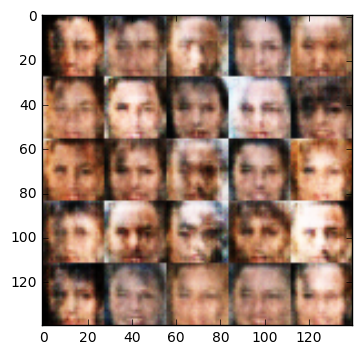

3801 Epoch 1/1... Discriminator Loss: 1.4061... Generator Loss: 0.7350
3802 Epoch 1/1... Discriminator Loss: 1.4071... Generator Loss: 0.7292
3803 Epoch 1/1... Discriminator Loss: 1.4300... Generator Loss: 0.7652
3804 Epoch 1/1... Discriminator Loss: 1.4424... Generator Loss: 0.7570
3805 Epoch 1/1... Discriminator Loss: 1.4439... Generator Loss: 0.7542
3806 Epoch 1/1... Discriminator Loss: 1.4099... Generator Loss: 0.7817
3807 Epoch 1/1... Discriminator Loss: 1.4057... Generator Loss: 0.7822
3808 Epoch 1/1... Discriminator Loss: 1.4163... Generator Loss: 0.7359
3809 Epoch 1/1... Discriminator Loss: 1.3954... Generator Loss: 0.7503
3810 Epoch 1/1... Discriminator Loss: 1.3721... Generator Loss: 0.8027
3811 Epoch 1/1... Discriminator Loss: 1.4212... Generator Loss: 0.7770
3812 Epoch 1/1... Discriminator Loss: 1.4192... Generator Loss: 0.7988
3813 Epoch 1/1... Discriminator Loss: 1.4300... Generator Loss: 0.7637
3814 Epoch 1/1... Discriminator Loss: 1.4169... Generator Loss: 0.7517
3815 E

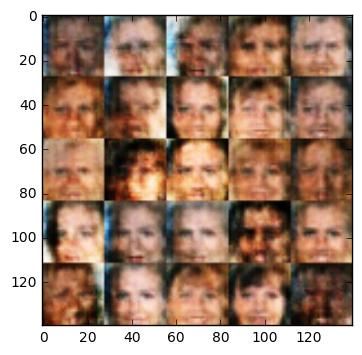

3901 Epoch 1/1... Discriminator Loss: 1.4483... Generator Loss: 0.8328
3902 Epoch 1/1... Discriminator Loss: 1.4116... Generator Loss: 0.8143
3903 Epoch 1/1... Discriminator Loss: 1.4038... Generator Loss: 0.7773
3904 Epoch 1/1... Discriminator Loss: 1.3993... Generator Loss: 0.7949
3905 Epoch 1/1... Discriminator Loss: 1.3725... Generator Loss: 0.8028
3906 Epoch 1/1... Discriminator Loss: 1.3844... Generator Loss: 0.8243
3907 Epoch 1/1... Discriminator Loss: 1.4295... Generator Loss: 0.7593
3908 Epoch 1/1... Discriminator Loss: 1.3832... Generator Loss: 0.7593
3909 Epoch 1/1... Discriminator Loss: 1.3909... Generator Loss: 0.7350
3910 Epoch 1/1... Discriminator Loss: 1.3920... Generator Loss: 0.7407
3911 Epoch 1/1... Discriminator Loss: 1.3764... Generator Loss: 0.7858
3912 Epoch 1/1... Discriminator Loss: 1.4170... Generator Loss: 0.8006
3913 Epoch 1/1... Discriminator Loss: 1.4200... Generator Loss: 0.7978
3914 Epoch 1/1... Discriminator Loss: 1.4256... Generator Loss: 0.7493
3915 E

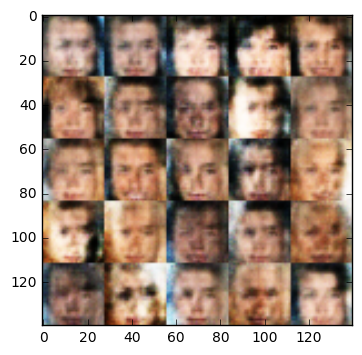

4001 Epoch 1/1... Discriminator Loss: 1.4276... Generator Loss: 0.7451
4002 Epoch 1/1... Discriminator Loss: 1.4249... Generator Loss: 0.7795
4003 Epoch 1/1... Discriminator Loss: 1.4723... Generator Loss: 0.7844
4004 Epoch 1/1... Discriminator Loss: 1.4205... Generator Loss: 0.7883
4005 Epoch 1/1... Discriminator Loss: 1.4254... Generator Loss: 0.7940
4006 Epoch 1/1... Discriminator Loss: 1.4409... Generator Loss: 0.7711
4007 Epoch 1/1... Discriminator Loss: 1.4416... Generator Loss: 0.7617
4008 Epoch 1/1... Discriminator Loss: 1.4453... Generator Loss: 0.7576
4009 Epoch 1/1... Discriminator Loss: 1.3918... Generator Loss: 0.8085
4010 Epoch 1/1... Discriminator Loss: 1.3931... Generator Loss: 0.8482
4011 Epoch 1/1... Discriminator Loss: 1.3111... Generator Loss: 0.8637
4012 Epoch 1/1... Discriminator Loss: 1.3875... Generator Loss: 0.7451
4013 Epoch 1/1... Discriminator Loss: 1.3938... Generator Loss: 0.7589
4014 Epoch 1/1... Discriminator Loss: 1.3976... Generator Loss: 0.7758
4015 E

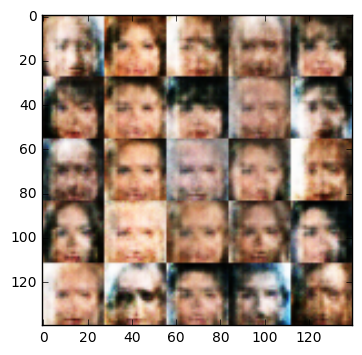

4101 Epoch 1/1... Discriminator Loss: 1.4584... Generator Loss: 0.7683
4102 Epoch 1/1... Discriminator Loss: 1.4195... Generator Loss: 0.8203
4103 Epoch 1/1... Discriminator Loss: 1.3984... Generator Loss: 0.7675
4104 Epoch 1/1... Discriminator Loss: 1.3845... Generator Loss: 0.7839
4105 Epoch 1/1... Discriminator Loss: 1.3925... Generator Loss: 0.8269
4106 Epoch 1/1... Discriminator Loss: 1.3817... Generator Loss: 0.8678
4107 Epoch 1/1... Discriminator Loss: 1.3700... Generator Loss: 0.8311
4108 Epoch 1/1... Discriminator Loss: 1.3725... Generator Loss: 0.7596
4109 Epoch 1/1... Discriminator Loss: 1.4340... Generator Loss: 0.7331
4110 Epoch 1/1... Discriminator Loss: 1.4069... Generator Loss: 0.7149
4111 Epoch 1/1... Discriminator Loss: 1.4142... Generator Loss: 0.7413
4112 Epoch 1/1... Discriminator Loss: 1.4302... Generator Loss: 0.7596
4113 Epoch 1/1... Discriminator Loss: 1.3715... Generator Loss: 0.8054
4114 Epoch 1/1... Discriminator Loss: 1.4168... Generator Loss: 0.7612
4115 E

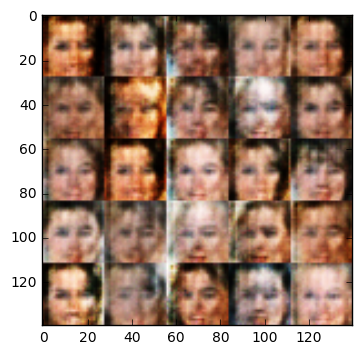

4201 Epoch 1/1... Discriminator Loss: 1.3816... Generator Loss: 0.8286
4202 Epoch 1/1... Discriminator Loss: 1.4211... Generator Loss: 0.7943
4203 Epoch 1/1... Discriminator Loss: 1.4319... Generator Loss: 0.7417
4204 Epoch 1/1... Discriminator Loss: 1.4208... Generator Loss: 0.7553
4205 Epoch 1/1... Discriminator Loss: 1.4163... Generator Loss: 0.7679
4206 Epoch 1/1... Discriminator Loss: 1.4159... Generator Loss: 0.7826
4207 Epoch 1/1... Discriminator Loss: 1.4227... Generator Loss: 0.7966
4208 Epoch 1/1... Discriminator Loss: 1.3977... Generator Loss: 0.8167
4209 Epoch 1/1... Discriminator Loss: 1.3905... Generator Loss: 0.7701
4210 Epoch 1/1... Discriminator Loss: 1.4152... Generator Loss: 0.7535
4211 Epoch 1/1... Discriminator Loss: 1.4372... Generator Loss: 0.7448
4212 Epoch 1/1... Discriminator Loss: 1.4242... Generator Loss: 0.7431
4213 Epoch 1/1... Discriminator Loss: 1.4322... Generator Loss: 0.7104
4214 Epoch 1/1... Discriminator Loss: 1.3779... Generator Loss: 0.7422
4215 E

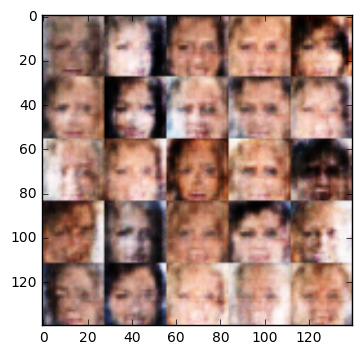

4301 Epoch 1/1... Discriminator Loss: 1.3637... Generator Loss: 0.8073
4302 Epoch 1/1... Discriminator Loss: 1.4059... Generator Loss: 0.7733
4303 Epoch 1/1... Discriminator Loss: 1.4397... Generator Loss: 0.7278
4304 Epoch 1/1... Discriminator Loss: 1.4186... Generator Loss: 0.7330
4305 Epoch 1/1... Discriminator Loss: 1.4432... Generator Loss: 0.7028
4306 Epoch 1/1... Discriminator Loss: 1.4618... Generator Loss: 0.6816
4307 Epoch 1/1... Discriminator Loss: 1.4671... Generator Loss: 0.7093
4308 Epoch 1/1... Discriminator Loss: 1.4014... Generator Loss: 0.7602
4309 Epoch 1/1... Discriminator Loss: 1.4541... Generator Loss: 0.7796
4310 Epoch 1/1... Discriminator Loss: 1.4819... Generator Loss: 0.7751
4311 Epoch 1/1... Discriminator Loss: 1.3898... Generator Loss: 0.8455
4312 Epoch 1/1... Discriminator Loss: 1.4057... Generator Loss: 0.8501
4313 Epoch 1/1... Discriminator Loss: 1.3954... Generator Loss: 0.8378
4314 Epoch 1/1... Discriminator Loss: 1.3854... Generator Loss: 0.7712
4315 E

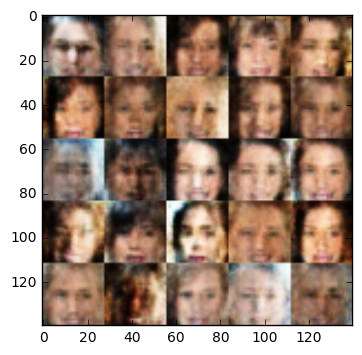

4401 Epoch 1/1... Discriminator Loss: 1.3822... Generator Loss: 0.7907
4402 Epoch 1/1... Discriminator Loss: 1.3934... Generator Loss: 0.7688
4403 Epoch 1/1... Discriminator Loss: 1.3761... Generator Loss: 0.7701
4404 Epoch 1/1... Discriminator Loss: 1.4626... Generator Loss: 0.7540
4405 Epoch 1/1... Discriminator Loss: 1.4235... Generator Loss: 0.8152
4406 Epoch 1/1... Discriminator Loss: 1.4033... Generator Loss: 0.8205
4407 Epoch 1/1... Discriminator Loss: 1.4218... Generator Loss: 0.7859
4408 Epoch 1/1... Discriminator Loss: 1.3855... Generator Loss: 0.7881
4409 Epoch 1/1... Discriminator Loss: 1.4529... Generator Loss: 0.7337
4410 Epoch 1/1... Discriminator Loss: 1.4267... Generator Loss: 0.7590
4411 Epoch 1/1... Discriminator Loss: 1.4182... Generator Loss: 0.7559
4412 Epoch 1/1... Discriminator Loss: 1.4122... Generator Loss: 0.7521
4413 Epoch 1/1... Discriminator Loss: 1.3750... Generator Loss: 0.7687
4414 Epoch 1/1... Discriminator Loss: 1.3714... Generator Loss: 0.7447
4415 E

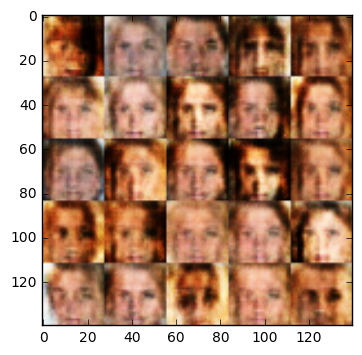

4501 Epoch 1/1... Discriminator Loss: 1.4119... Generator Loss: 0.7646
4502 Epoch 1/1... Discriminator Loss: 1.4079... Generator Loss: 0.7515
4503 Epoch 1/1... Discriminator Loss: 1.4222... Generator Loss: 0.7368
4504 Epoch 1/1... Discriminator Loss: 1.4501... Generator Loss: 0.7776
4505 Epoch 1/1... Discriminator Loss: 1.4095... Generator Loss: 0.8017
4506 Epoch 1/1... Discriminator Loss: 1.4156... Generator Loss: 0.8197
4507 Epoch 1/1... Discriminator Loss: 1.4086... Generator Loss: 0.7785
4508 Epoch 1/1... Discriminator Loss: 1.4013... Generator Loss: 0.7884
4509 Epoch 1/1... Discriminator Loss: 1.3864... Generator Loss: 0.7808
4510 Epoch 1/1... Discriminator Loss: 1.4394... Generator Loss: 0.7265
4511 Epoch 1/1... Discriminator Loss: 1.4322... Generator Loss: 0.7477
4512 Epoch 1/1... Discriminator Loss: 1.3581... Generator Loss: 0.8012
4513 Epoch 1/1... Discriminator Loss: 1.4035... Generator Loss: 0.7565
4514 Epoch 1/1... Discriminator Loss: 1.3807... Generator Loss: 0.7893
4515 E

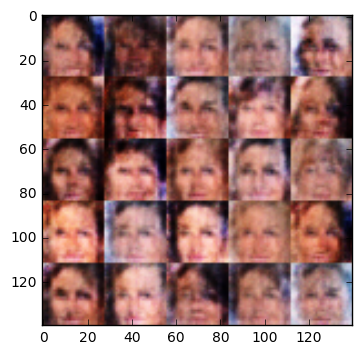

4601 Epoch 1/1... Discriminator Loss: 1.3644... Generator Loss: 0.8145
4602 Epoch 1/1... Discriminator Loss: 1.3722... Generator Loss: 0.8058
4603 Epoch 1/1... Discriminator Loss: 1.3922... Generator Loss: 0.7963
4604 Epoch 1/1... Discriminator Loss: 1.3788... Generator Loss: 0.7568
4605 Epoch 1/1... Discriminator Loss: 1.3870... Generator Loss: 0.7717
4606 Epoch 1/1... Discriminator Loss: 1.4000... Generator Loss: 0.7770
4607 Epoch 1/1... Discriminator Loss: 1.4166... Generator Loss: 0.7913
4608 Epoch 1/1... Discriminator Loss: 1.3924... Generator Loss: 0.8030
4609 Epoch 1/1... Discriminator Loss: 1.4082... Generator Loss: 0.7598
4610 Epoch 1/1... Discriminator Loss: 1.4349... Generator Loss: 0.7902
4611 Epoch 1/1... Discriminator Loss: 1.4528... Generator Loss: 0.8209
4612 Epoch 1/1... Discriminator Loss: 1.4164... Generator Loss: 0.7742
4613 Epoch 1/1... Discriminator Loss: 1.4147... Generator Loss: 0.7485
4614 Epoch 1/1... Discriminator Loss: 1.4167... Generator Loss: 0.7581
4615 E

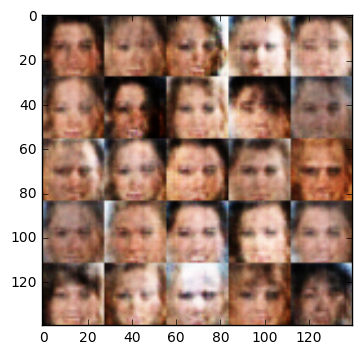

4701 Epoch 1/1... Discriminator Loss: 1.4100... Generator Loss: 0.7725
4702 Epoch 1/1... Discriminator Loss: 1.3685... Generator Loss: 0.8111
4703 Epoch 1/1... Discriminator Loss: 1.4119... Generator Loss: 0.7758
4704 Epoch 1/1... Discriminator Loss: 1.4061... Generator Loss: 0.7690
4705 Epoch 1/1... Discriminator Loss: 1.4132... Generator Loss: 0.7776
4706 Epoch 1/1... Discriminator Loss: 1.4127... Generator Loss: 0.7455
4707 Epoch 1/1... Discriminator Loss: 1.3877... Generator Loss: 0.7677
4708 Epoch 1/1... Discriminator Loss: 1.4351... Generator Loss: 0.7839
4709 Epoch 1/1... Discriminator Loss: 1.3952... Generator Loss: 0.8146
4710 Epoch 1/1... Discriminator Loss: 1.4045... Generator Loss: 0.8256
4711 Epoch 1/1... Discriminator Loss: 1.4335... Generator Loss: 0.8033
4712 Epoch 1/1... Discriminator Loss: 1.3910... Generator Loss: 0.8259
4713 Epoch 1/1... Discriminator Loss: 1.3985... Generator Loss: 0.8160
4714 Epoch 1/1... Discriminator Loss: 1.3671... Generator Loss: 0.8066
4715 E

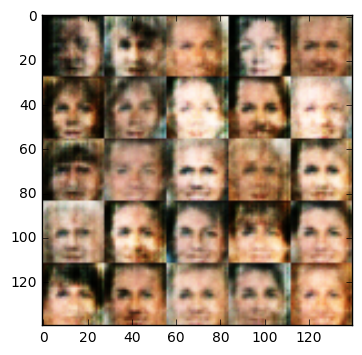

4801 Epoch 1/1... Discriminator Loss: 1.4214... Generator Loss: 0.7609
4802 Epoch 1/1... Discriminator Loss: 1.4009... Generator Loss: 0.7354
4803 Epoch 1/1... Discriminator Loss: 1.4407... Generator Loss: 0.7505
4804 Epoch 1/1... Discriminator Loss: 1.4325... Generator Loss: 0.7584
4805 Epoch 1/1... Discriminator Loss: 1.4391... Generator Loss: 0.7647
4806 Epoch 1/1... Discriminator Loss: 1.4362... Generator Loss: 0.7398
4807 Epoch 1/1... Discriminator Loss: 1.4475... Generator Loss: 0.7498
4808 Epoch 1/1... Discriminator Loss: 1.4494... Generator Loss: 0.7980
4809 Epoch 1/1... Discriminator Loss: 1.4254... Generator Loss: 0.8020
4810 Epoch 1/1... Discriminator Loss: 1.4319... Generator Loss: 0.7806
4811 Epoch 1/1... Discriminator Loss: 1.4314... Generator Loss: 0.7471
4812 Epoch 1/1... Discriminator Loss: 1.3943... Generator Loss: 0.7729
4813 Epoch 1/1... Discriminator Loss: 1.3859... Generator Loss: 0.7793
4814 Epoch 1/1... Discriminator Loss: 1.3883... Generator Loss: 0.7505
4815 E

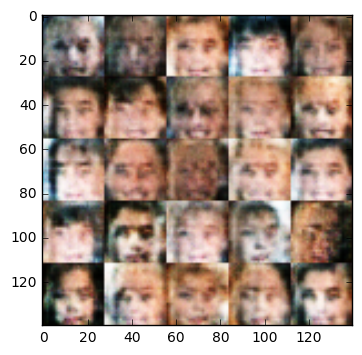

4901 Epoch 1/1... Discriminator Loss: 1.3904... Generator Loss: 0.7485
4902 Epoch 1/1... Discriminator Loss: 1.4182... Generator Loss: 0.7406
4903 Epoch 1/1... Discriminator Loss: 1.4223... Generator Loss: 0.7341
4904 Epoch 1/1... Discriminator Loss: 1.4225... Generator Loss: 0.7262
4905 Epoch 1/1... Discriminator Loss: 1.4207... Generator Loss: 0.7492
4906 Epoch 1/1... Discriminator Loss: 1.4028... Generator Loss: 0.8086
4907 Epoch 1/1... Discriminator Loss: 1.4015... Generator Loss: 0.8036
4908 Epoch 1/1... Discriminator Loss: 1.4124... Generator Loss: 0.7903
4909 Epoch 1/1... Discriminator Loss: 1.4092... Generator Loss: 0.7336
4910 Epoch 1/1... Discriminator Loss: 1.4403... Generator Loss: 0.7089
4911 Epoch 1/1... Discriminator Loss: 1.4095... Generator Loss: 0.7443
4912 Epoch 1/1... Discriminator Loss: 1.4185... Generator Loss: 0.7705
4913 Epoch 1/1... Discriminator Loss: 1.3855... Generator Loss: 0.8170
4914 Epoch 1/1... Discriminator Loss: 1.3965... Generator Loss: 0.8600
4915 E

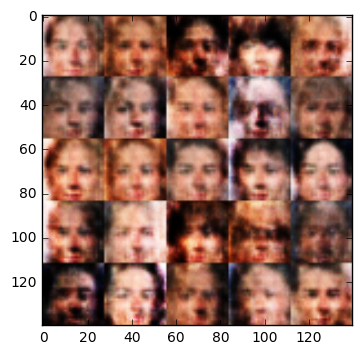

5001 Epoch 1/1... Discriminator Loss: 1.3814... Generator Loss: 0.7711
5002 Epoch 1/1... Discriminator Loss: 1.3989... Generator Loss: 0.7665
5003 Epoch 1/1... Discriminator Loss: 1.4396... Generator Loss: 0.7476
5004 Epoch 1/1... Discriminator Loss: 1.4190... Generator Loss: 0.7411
5005 Epoch 1/1... Discriminator Loss: 1.4122... Generator Loss: 0.7569
5006 Epoch 1/1... Discriminator Loss: 1.4129... Generator Loss: 0.7634
5007 Epoch 1/1... Discriminator Loss: 1.4088... Generator Loss: 0.7881
5008 Epoch 1/1... Discriminator Loss: 1.3957... Generator Loss: 0.8020
5009 Epoch 1/1... Discriminator Loss: 1.4225... Generator Loss: 0.8076
5010 Epoch 1/1... Discriminator Loss: 1.4124... Generator Loss: 0.7742
5011 Epoch 1/1... Discriminator Loss: 1.3832... Generator Loss: 0.7749
5012 Epoch 1/1... Discriminator Loss: 1.4201... Generator Loss: 0.7664
5013 Epoch 1/1... Discriminator Loss: 1.3998... Generator Loss: 0.7969
5014 Epoch 1/1... Discriminator Loss: 1.3982... Generator Loss: 0.7717
5015 E

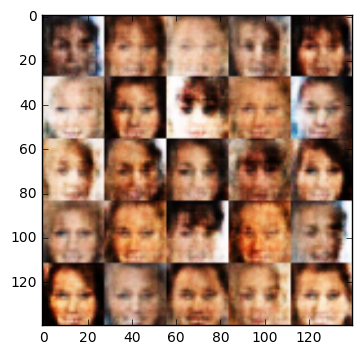

5101 Epoch 1/1... Discriminator Loss: 1.3938... Generator Loss: 0.7751
5102 Epoch 1/1... Discriminator Loss: 1.3712... Generator Loss: 0.8163
5103 Epoch 1/1... Discriminator Loss: 1.4172... Generator Loss: 0.8389
5104 Epoch 1/1... Discriminator Loss: 1.3811... Generator Loss: 0.8131
5105 Epoch 1/1... Discriminator Loss: 1.4473... Generator Loss: 0.7411
5106 Epoch 1/1... Discriminator Loss: 1.4102... Generator Loss: 0.7671
5107 Epoch 1/1... Discriminator Loss: 1.4487... Generator Loss: 0.7638
5108 Epoch 1/1... Discriminator Loss: 1.4588... Generator Loss: 0.7761
5109 Epoch 1/1... Discriminator Loss: 1.4170... Generator Loss: 0.7996
5110 Epoch 1/1... Discriminator Loss: 1.4247... Generator Loss: 0.7611
5111 Epoch 1/1... Discriminator Loss: 1.4167... Generator Loss: 0.7484
5112 Epoch 1/1... Discriminator Loss: 1.4293... Generator Loss: 0.7389
5113 Epoch 1/1... Discriminator Loss: 1.4199... Generator Loss: 0.7566
5114 Epoch 1/1... Discriminator Loss: 1.4052... Generator Loss: 0.7521
5115 E

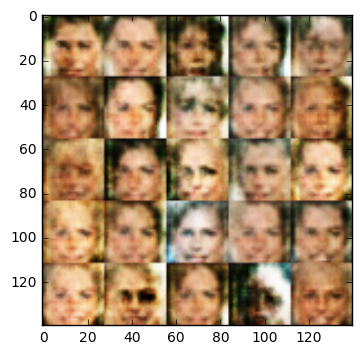

5201 Epoch 1/1... Discriminator Loss: 1.4601... Generator Loss: 0.7506
5202 Epoch 1/1... Discriminator Loss: 1.4140... Generator Loss: 0.7562
5203 Epoch 1/1... Discriminator Loss: 1.3957... Generator Loss: 0.7827
5204 Epoch 1/1... Discriminator Loss: 1.4156... Generator Loss: 0.7921
5205 Epoch 1/1... Discriminator Loss: 1.4162... Generator Loss: 0.7864
5206 Epoch 1/1... Discriminator Loss: 1.3980... Generator Loss: 0.7591
5207 Epoch 1/1... Discriminator Loss: 1.4025... Generator Loss: 0.7857
5208 Epoch 1/1... Discriminator Loss: 1.3829... Generator Loss: 0.8072
5209 Epoch 1/1... Discriminator Loss: 1.4058... Generator Loss: 0.7926
5210 Epoch 1/1... Discriminator Loss: 1.3809... Generator Loss: 0.7989
5211 Epoch 1/1... Discriminator Loss: 1.3962... Generator Loss: 0.8005
5212 Epoch 1/1... Discriminator Loss: 1.4260... Generator Loss: 0.7613
5213 Epoch 1/1... Discriminator Loss: 1.4066... Generator Loss: 0.7684
5214 Epoch 1/1... Discriminator Loss: 1.4107... Generator Loss: 0.7464
5215 E

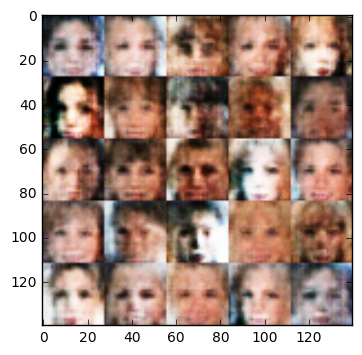

5301 Epoch 1/1... Discriminator Loss: 1.3958... Generator Loss: 0.7699
5302 Epoch 1/1... Discriminator Loss: 1.4058... Generator Loss: 0.7819
5303 Epoch 1/1... Discriminator Loss: 1.4484... Generator Loss: 0.7655
5304 Epoch 1/1... Discriminator Loss: 1.4053... Generator Loss: 0.7727
5305 Epoch 1/1... Discriminator Loss: 1.4282... Generator Loss: 0.7917
5306 Epoch 1/1... Discriminator Loss: 1.4084... Generator Loss: 0.8395
5307 Epoch 1/1... Discriminator Loss: 1.4010... Generator Loss: 0.8073
5308 Epoch 1/1... Discriminator Loss: 1.3595... Generator Loss: 0.8191
5309 Epoch 1/1... Discriminator Loss: 1.3829... Generator Loss: 0.7856
5310 Epoch 1/1... Discriminator Loss: 1.4035... Generator Loss: 0.7375
5311 Epoch 1/1... Discriminator Loss: 1.4102... Generator Loss: 0.7558
5312 Epoch 1/1... Discriminator Loss: 1.4314... Generator Loss: 0.7411
5313 Epoch 1/1... Discriminator Loss: 1.3938... Generator Loss: 0.7785
5314 Epoch 1/1... Discriminator Loss: 1.3920... Generator Loss: 0.7843
5315 E

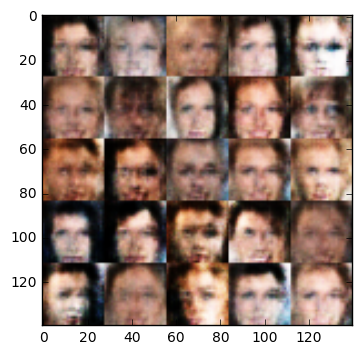

5401 Epoch 1/1... Discriminator Loss: 1.3649... Generator Loss: 0.8234
5402 Epoch 1/1... Discriminator Loss: 1.4132... Generator Loss: 0.8040
5403 Epoch 1/1... Discriminator Loss: 1.4289... Generator Loss: 0.7545
5404 Epoch 1/1... Discriminator Loss: 1.4146... Generator Loss: 0.7350
5405 Epoch 1/1... Discriminator Loss: 1.3616... Generator Loss: 0.7424
5406 Epoch 1/1... Discriminator Loss: 1.3766... Generator Loss: 0.7558
5407 Epoch 1/1... Discriminator Loss: 1.4071... Generator Loss: 0.7654
5408 Epoch 1/1... Discriminator Loss: 1.4319... Generator Loss: 0.7639
5409 Epoch 1/1... Discriminator Loss: 1.4296... Generator Loss: 0.7846
5410 Epoch 1/1... Discriminator Loss: 1.4164... Generator Loss: 0.7938
5411 Epoch 1/1... Discriminator Loss: 1.3907... Generator Loss: 0.7510
5412 Epoch 1/1... Discriminator Loss: 1.4228... Generator Loss: 0.7216
5413 Epoch 1/1... Discriminator Loss: 1.3935... Generator Loss: 0.7765
5414 Epoch 1/1... Discriminator Loss: 1.4343... Generator Loss: 0.8049
5415 E

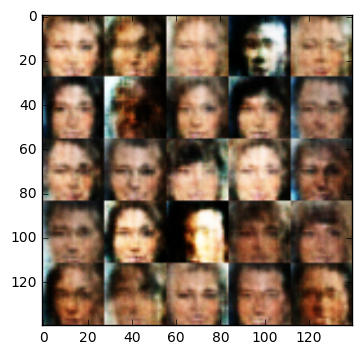

5501 Epoch 1/1... Discriminator Loss: 1.4294... Generator Loss: 0.7390
5502 Epoch 1/1... Discriminator Loss: 1.4363... Generator Loss: 0.7804
5503 Epoch 1/1... Discriminator Loss: 1.4034... Generator Loss: 0.7989
5504 Epoch 1/1... Discriminator Loss: 1.4298... Generator Loss: 0.7764
5505 Epoch 1/1... Discriminator Loss: 1.4130... Generator Loss: 0.7716
5506 Epoch 1/1... Discriminator Loss: 1.4044... Generator Loss: 0.7730
5507 Epoch 1/1... Discriminator Loss: 1.3741... Generator Loss: 0.7783
5508 Epoch 1/1... Discriminator Loss: 1.3540... Generator Loss: 0.8182
5509 Epoch 1/1... Discriminator Loss: 1.3757... Generator Loss: 0.8094
5510 Epoch 1/1... Discriminator Loss: 1.3955... Generator Loss: 0.8104
5511 Epoch 1/1... Discriminator Loss: 1.3668... Generator Loss: 0.8102
5512 Epoch 1/1... Discriminator Loss: 1.4184... Generator Loss: 0.7545
5513 Epoch 1/1... Discriminator Loss: 1.4265... Generator Loss: 0.7439
5514 Epoch 1/1... Discriminator Loss: 1.4011... Generator Loss: 0.7707
5515 E

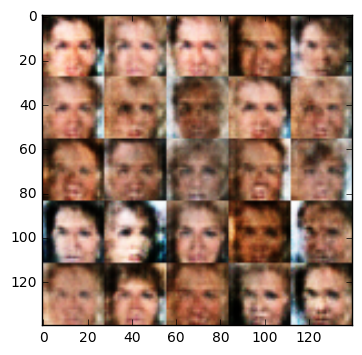

5601 Epoch 1/1... Discriminator Loss: 1.3689... Generator Loss: 0.7777
5602 Epoch 1/1... Discriminator Loss: 1.3837... Generator Loss: 0.7882
5603 Epoch 1/1... Discriminator Loss: 1.4145... Generator Loss: 0.8108
5604 Epoch 1/1... Discriminator Loss: 1.4255... Generator Loss: 0.7888
5605 Epoch 1/1... Discriminator Loss: 1.4437... Generator Loss: 0.7876
5606 Epoch 1/1... Discriminator Loss: 1.4157... Generator Loss: 0.7732
5607 Epoch 1/1... Discriminator Loss: 1.3985... Generator Loss: 0.7670
5608 Epoch 1/1... Discriminator Loss: 1.3998... Generator Loss: 0.7513
5609 Epoch 1/1... Discriminator Loss: 1.4182... Generator Loss: 0.7609
5610 Epoch 1/1... Discriminator Loss: 1.4425... Generator Loss: 0.7289
5611 Epoch 1/1... Discriminator Loss: 1.4229... Generator Loss: 0.7408
5612 Epoch 1/1... Discriminator Loss: 1.4066... Generator Loss: 0.7783
5613 Epoch 1/1... Discriminator Loss: 1.4036... Generator Loss: 0.7942
5614 Epoch 1/1... Discriminator Loss: 1.3991... Generator Loss: 0.8025
5615 E

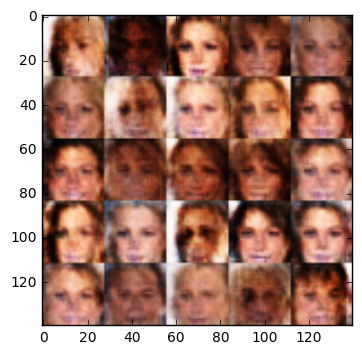

5701 Epoch 1/1... Discriminator Loss: 1.4048... Generator Loss: 0.7676
5702 Epoch 1/1... Discriminator Loss: 1.3786... Generator Loss: 0.7654
5703 Epoch 1/1... Discriminator Loss: 1.4043... Generator Loss: 0.7830
5704 Epoch 1/1... Discriminator Loss: 1.4023... Generator Loss: 0.8274
5705 Epoch 1/1... Discriminator Loss: 1.3827... Generator Loss: 0.8322
5706 Epoch 1/1... Discriminator Loss: 1.3910... Generator Loss: 0.7852
5707 Epoch 1/1... Discriminator Loss: 1.4328... Generator Loss: 0.7650
5708 Epoch 1/1... Discriminator Loss: 1.4247... Generator Loss: 0.7605
5709 Epoch 1/1... Discriminator Loss: 1.3892... Generator Loss: 0.7632
5710 Epoch 1/1... Discriminator Loss: 1.4308... Generator Loss: 0.7585
5711 Epoch 1/1... Discriminator Loss: 1.4206... Generator Loss: 0.7486
5712 Epoch 1/1... Discriminator Loss: 1.4177... Generator Loss: 0.7787
5713 Epoch 1/1... Discriminator Loss: 1.3806... Generator Loss: 0.8031
5714 Epoch 1/1... Discriminator Loss: 1.3992... Generator Loss: 0.7916
5715 E

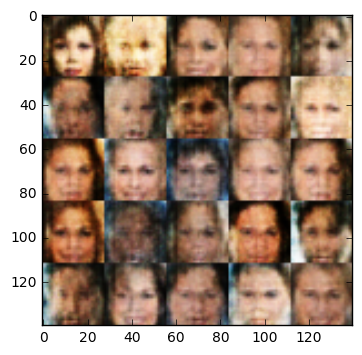

5801 Epoch 1/1... Discriminator Loss: 1.4171... Generator Loss: 0.7616
5802 Epoch 1/1... Discriminator Loss: 1.4035... Generator Loss: 0.7676
5803 Epoch 1/1... Discriminator Loss: 1.4321... Generator Loss: 0.7893
5804 Epoch 1/1... Discriminator Loss: 1.4165... Generator Loss: 0.8191
5805 Epoch 1/1... Discriminator Loss: 1.4018... Generator Loss: 0.8020
5806 Epoch 1/1... Discriminator Loss: 1.4019... Generator Loss: 0.7466
5807 Epoch 1/1... Discriminator Loss: 1.4114... Generator Loss: 0.7884
5808 Epoch 1/1... Discriminator Loss: 1.4018... Generator Loss: 0.7824
5809 Epoch 1/1... Discriminator Loss: 1.3715... Generator Loss: 0.8052
5810 Epoch 1/1... Discriminator Loss: 1.3903... Generator Loss: 0.7800
5811 Epoch 1/1... Discriminator Loss: 1.3735... Generator Loss: 0.7600
5812 Epoch 1/1... Discriminator Loss: 1.3698... Generator Loss: 0.7950
5813 Epoch 1/1... Discriminator Loss: 1.4436... Generator Loss: 0.7798
5814 Epoch 1/1... Discriminator Loss: 1.3744... Generator Loss: 0.7794
5815 E

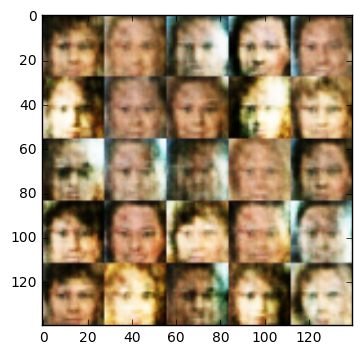

5901 Epoch 1/1... Discriminator Loss: 1.4061... Generator Loss: 0.7857
5902 Epoch 1/1... Discriminator Loss: 1.4066... Generator Loss: 0.7753
5903 Epoch 1/1... Discriminator Loss: 1.4265... Generator Loss: 0.8047
5904 Epoch 1/1... Discriminator Loss: 1.4196... Generator Loss: 0.8240
5905 Epoch 1/1... Discriminator Loss: 1.4209... Generator Loss: 0.8083
5906 Epoch 1/1... Discriminator Loss: 1.4051... Generator Loss: 0.7976
5907 Epoch 1/1... Discriminator Loss: 1.3893... Generator Loss: 0.7643
5908 Epoch 1/1... Discriminator Loss: 1.3949... Generator Loss: 0.7447
5909 Epoch 1/1... Discriminator Loss: 1.4163... Generator Loss: 0.7557
5910 Epoch 1/1... Discriminator Loss: 1.4027... Generator Loss: 0.7747
5911 Epoch 1/1... Discriminator Loss: 1.3982... Generator Loss: 0.8104
5912 Epoch 1/1... Discriminator Loss: 1.4101... Generator Loss: 0.7915
5913 Epoch 1/1... Discriminator Loss: 1.3998... Generator Loss: 0.7716
5914 Epoch 1/1... Discriminator Loss: 1.4158... Generator Loss: 0.7536
5915 E

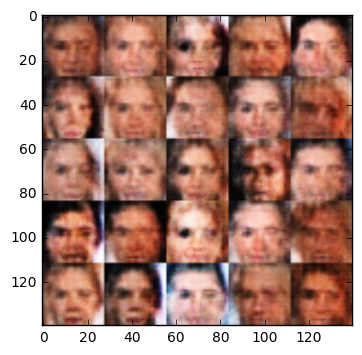

6001 Epoch 1/1... Discriminator Loss: 1.3829... Generator Loss: 0.7871
6002 Epoch 1/1... Discriminator Loss: 1.3834... Generator Loss: 0.7845
6003 Epoch 1/1... Discriminator Loss: 1.3773... Generator Loss: 0.7778
6004 Epoch 1/1... Discriminator Loss: 1.3908... Generator Loss: 0.7898
6005 Epoch 1/1... Discriminator Loss: 1.4166... Generator Loss: 0.7863
6006 Epoch 1/1... Discriminator Loss: 1.4320... Generator Loss: 0.7571
6007 Epoch 1/1... Discriminator Loss: 1.4101... Generator Loss: 0.7378
6008 Epoch 1/1... Discriminator Loss: 1.4170... Generator Loss: 0.7532
6009 Epoch 1/1... Discriminator Loss: 1.4107... Generator Loss: 0.7511
6010 Epoch 1/1... Discriminator Loss: 1.4177... Generator Loss: 0.7740
6011 Epoch 1/1... Discriminator Loss: 1.3862... Generator Loss: 0.8028
6012 Epoch 1/1... Discriminator Loss: 1.3834... Generator Loss: 0.7877
6013 Epoch 1/1... Discriminator Loss: 1.3827... Generator Loss: 0.7728
6014 Epoch 1/1... Discriminator Loss: 1.3943... Generator Loss: 0.7782
6015 E

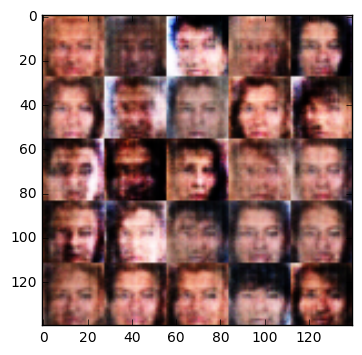

6101 Epoch 1/1... Discriminator Loss: 1.4225... Generator Loss: 0.7980
6102 Epoch 1/1... Discriminator Loss: 1.4014... Generator Loss: 0.7836
6103 Epoch 1/1... Discriminator Loss: 1.4258... Generator Loss: 0.7723
6104 Epoch 1/1... Discriminator Loss: 1.4287... Generator Loss: 0.7534
6105 Epoch 1/1... Discriminator Loss: 1.4253... Generator Loss: 0.7577
6106 Epoch 1/1... Discriminator Loss: 1.3605... Generator Loss: 0.8025
6107 Epoch 1/1... Discriminator Loss: 1.3852... Generator Loss: 0.7993
6108 Epoch 1/1... Discriminator Loss: 1.3941... Generator Loss: 0.7774
6109 Epoch 1/1... Discriminator Loss: 1.3486... Generator Loss: 0.7522
6110 Epoch 1/1... Discriminator Loss: 1.3596... Generator Loss: 0.7405
6111 Epoch 1/1... Discriminator Loss: 1.3673... Generator Loss: 0.7619
6112 Epoch 1/1... Discriminator Loss: 1.4412... Generator Loss: 0.7805
6113 Epoch 1/1... Discriminator Loss: 1.3831... Generator Loss: 0.8169
6114 Epoch 1/1... Discriminator Loss: 1.4203... Generator Loss: 0.8371
6115 E

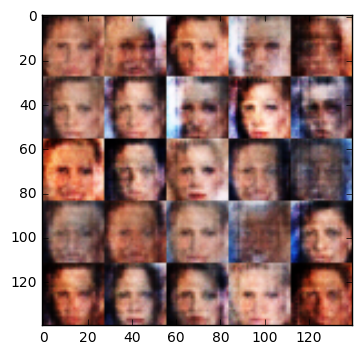

6201 Epoch 1/1... Discriminator Loss: 1.4264... Generator Loss: 0.7763
6202 Epoch 1/1... Discriminator Loss: 1.4002... Generator Loss: 0.7769
6203 Epoch 1/1... Discriminator Loss: 1.3871... Generator Loss: 0.7849
6204 Epoch 1/1... Discriminator Loss: 1.4134... Generator Loss: 0.7615
6205 Epoch 1/1... Discriminator Loss: 1.3955... Generator Loss: 0.7787
6206 Epoch 1/1... Discriminator Loss: 1.3769... Generator Loss: 0.8350
6207 Epoch 1/1... Discriminator Loss: 1.3792... Generator Loss: 0.8251
6208 Epoch 1/1... Discriminator Loss: 1.3983... Generator Loss: 0.7754
6209 Epoch 1/1... Discriminator Loss: 1.4060... Generator Loss: 0.7990
6210 Epoch 1/1... Discriminator Loss: 1.3914... Generator Loss: 0.7894
6211 Epoch 1/1... Discriminator Loss: 1.3698... Generator Loss: 0.7838
6212 Epoch 1/1... Discriminator Loss: 1.4341... Generator Loss: 0.7369
6213 Epoch 1/1... Discriminator Loss: 1.4029... Generator Loss: 0.7331
6214 Epoch 1/1... Discriminator Loss: 1.4315... Generator Loss: 0.7399
6215 E

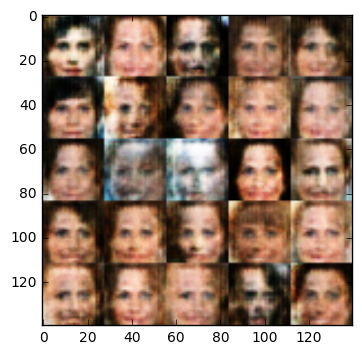

6301 Epoch 1/1... Discriminator Loss: 1.3890... Generator Loss: 0.7491
6302 Epoch 1/1... Discriminator Loss: 1.4240... Generator Loss: 0.7404
6303 Epoch 1/1... Discriminator Loss: 1.4024... Generator Loss: 0.7722
6304 Epoch 1/1... Discriminator Loss: 1.4343... Generator Loss: 0.7835
6305 Epoch 1/1... Discriminator Loss: 1.4374... Generator Loss: 0.7483
6306 Epoch 1/1... Discriminator Loss: 1.4468... Generator Loss: 0.7696
6307 Epoch 1/1... Discriminator Loss: 1.4056... Generator Loss: 0.7988
6308 Epoch 1/1... Discriminator Loss: 1.4185... Generator Loss: 0.7658
6309 Epoch 1/1... Discriminator Loss: 1.3830... Generator Loss: 0.7665
6310 Epoch 1/1... Discriminator Loss: 1.3665... Generator Loss: 0.7504
6311 Epoch 1/1... Discriminator Loss: 1.3742... Generator Loss: 0.7733
6312 Epoch 1/1... Discriminator Loss: 1.3508... Generator Loss: 0.8183
6313 Epoch 1/1... Discriminator Loss: 1.3839... Generator Loss: 0.8018
6314 Epoch 1/1... Discriminator Loss: 1.4273... Generator Loss: 0.7653
6315 E

In [13]:
batch_size = 32
z_dim = 100
learning_rate = 0.0001
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.